<a href="https://colab.research.google.com/github/danielav081596/Proyecto_Integrador_Equipo5/blob/main/Avance5_Equipo_5_Adultos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


#**Instituto Tecnológico y de Estudios Superiores de Monterrey**

##**Maestría en Inteligencia Artificial Aplicada**

### TC5035.10 Proyecto Integrador - "Modelación y predicción del impacto de las experiencias benevolentes en la infancia en las Condiciones de Bienestar Emocional (BCEs) en niños y adultos mexicanos"


#### Dra. Grettel Barceló Alonso - Asesor del proyecto

*Avance 3. Baseline*


**Equipo # 5**
* Karla Daniela Valenzuela A00819192
* Emmanuel Domínguez Bravo A01793683


In [ ]:
#!pip install pyreadstat

In [156]:
#!pip install feature-engine

In [157]:
#!pip install prince

In [158]:
#!pip install sweetviz

In [232]:
# importamos las librerías requeridas

import numpy as np
import pandas as pd
#import pyreadstat
import matplotlib.pyplot as plt
import seaborn as sns
#import sweetviz as sv
from tabulate import tabulate
from sklearn.feature_selection import chi2
from sklearn import metrics
from sklearn.model_selection import cross_validate
from sklearn.metrics import RocCurveDisplay
from collections import Counter
from sklearn import tree
import pydotplus
from IPython.display import Image
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV
from scipy.stats import boxcox
from sklearn.compose import ColumnTransformer
from sklearn.dummy import DummyClassifier
from sklearn.preprocessing import power_transform
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold

from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, FunctionTransformer
from feature_engine.encoding import OrdinalEncoder
from feature_engine.encoding import OneHotEncoder
from scipy.stats import chi2_contingency
from sklearn.feature_selection import chi2


from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold

from sklearn.model_selection import validation_curve
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import learning_curve, validation_curve

from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from numpy.core.function_base import linspace
from sklearn.metrics import classification_report
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier

from sklearn.decomposition import PCA
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor

from imblearn.under_sampling import TomekLinks
from imblearn.under_sampling import EditedNearestNeighbours

from imblearn.over_sampling import SMOTE

from imblearn.combine import SMOTEENN
from imblearn.combine import SMOTETomek
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler


from sklearn.metrics import classification_report, make_scorer, recall_score
from imblearn.metrics import geometric_mean_score, classification_report_imbalanced
from sklearn.model_selection import cross_val_score, cross_validate, RepeatedStratifiedKFold


In [159]:
#! git clone https://github.com/danielav081596/Proyecto_Integrador_Equipo5.git

In [233]:
# Creamos un dataframe del archivo .csv

df_adultos = pd.read_csv('/content/Proyecto_Integrador_Equipo5/ACEs Adultos.csv', encoding='latin1')


In [234]:
# La base de datos tiene 689 columnas:

df_adultos.head()

,FOLIO,FOLIO2,ID_ADULTO,TELEFONO,CORREO,BINOMIO,FILTRO,ENT,ENTIDAD,MUN,...,EDAD,INDIGENA,RELIGION,ESCOLARIDAD,NSEF,NSE5F,UPM,RURAL,PONDERADOR,AREA
0,0100108639999001-01,0100108639999001-01,1.0,4.493858e+09,yeimider1@gmail.com,1,2,1,AGUASCALIENTES,1,...,26.0,2.0,1.0,2.0,3.0,5.0,0100108639999,1.0,18619.783203,1.0
1,0100108639999001-02,0100108639999001-02,3.0,4.495684e+09,NaN,0,2,1,AGUASCALIENTES,1,...,32.0,2.0,1.0,2.0,3.0,5.0,0100108639999,1.0,18619.783203,1.0
2,0100108639999001-03,0100108639999001-03,1.0,4.494059e+09,Betomartiez89@gmail.com,1,2,1,AGUASCALIENTES,1,...,30.0,2.0,1.0,2.0,3.0,5.0,0100108639999,1.0,18619.783203,1.0
3,0100108639999001-04,0100108639999001-04,1.0,4.496682e+09,NaN,1,2,1,AGUASCALIENTES,1,...,26.0,2.0,1.0,2.0,1.0,1.0,0100108639999,1.0,18619.783203,1.0
4,0100108639999001-05,0100108639999001-05,1.0,4.492521e+09,NaN,1,2,1,AGUASCALIENTES,1,...,32.0,2.0,1.0,2.0,2.0,3.0,0100108639999,1.0,18619.783203,1.0


In [235]:
# Renombramos columnas para facilitar su identificación

survey = {'AD_M07_50':"Seguridad alimentaria 2",'AD_M07_51':"Seguridad alimentaria 3",'AD_M07_52':"Seguridad alimentaria 4",
                     'AD_M07_53':"Seguridad alimentaria 5",'AD_M07_54':"Seguridad alimentaria 6",'AD_M07_55':"Seguridad alimentaria 7",
                     'AD_M09_95_01_1':"comportamiento_riesgo 1",'AD_M09_95_01_2':"comportamiento_riesgo 2",'AD_M09_95_01_3':"comportamiento_riesgo 3",'AD_M09_95_01_4':"comportamiento_riesgo 4",
                     'AD_M09_95_02_1':"comportamiento_riesgo 5",'AD_M09_95_02_2':"comportamiento_riesgo 6",'AD_M09_95_02_3':"comportamiento_riesgo 7",'AD_M09_95_02_4':"comportamiento_riesgo 8",
                     'AD_M09_95_03_1':"comportamiento_riesgo 9",'AD_M09_95_03_2':"comportamiento_riesgo 10",'AD_M09_95_03_3':"comportamiento_riesgo 11",'AD_M09_95_03_4':"comportamiento_riesgo 12",
                     'AD_M09_95_04_1':"comportamiento_riesgo 13",'AD_M09_95_04_2':"comportamiento_riesgo 14",'AD_M09_95_04_3':"comportamiento_riesgo 15",'AD_M09_95_04_4':"comportamiento_riesgo 16",
                     'AD_M09_95_05_1':"comportamiento_riesgo 17",'AD_M09_95_05_2':"comportamiento_riesgo 18",'AD_M09_95_05_3':"comportamiento_riesgo 19",'AD_M09_95_05_4':"comportamiento_riesgo 20",
                     'AD_M09_95_06_1':"comportamiento_riesgo 21",'AD_M09_95_06_2':"comportamiento_riesgo 22",'AD_M09_95_06_3':"comportamiento_riesgo 23",'AD_M09_95_06_4':"comportamiento_riesgo 24",
                     'AD_M09_96_01_1':"Depresión_pregunta",'AD_M09_96_02_1':"Trastorno Bipolar_pregunta",'AD_M09_96_03_1':"Ezquizofrenia_pregunta",'AD_M09_96_04_1':"Estrés postrauma_pregunta",
                     'AD_M09_96_05_1':"Anorexia Nerviosa_pregunta",'AD_M09_96_06_1':"Bulimia Nerviosa_pregunta",'AD_M09_96_07_1':"Ansiedad_encuesta", 'AD_M09_96_08_1':'TRASTORNO_LÍMITE_PERSONALIDAD_pregunta',
                     'AD_M09_96_09_1':"Ideación Suicida_pregunta",'AD_M09_96_10_1':"AUTOLESIONES NO SUICIDAS_pregunta",'AD_M09_96_11_1':"DÉFICIT_ATENCIÓN_HIPERACTIVIDAD_pregunta",'AD_M09_96_12_1':"Alcoholismo",
                     'AD_M09_96_13_1':"Consumo_Sustancias_pregunta",'AD_M09_96_14_1':"Autismo_pregunta",'AD_M09_96_15_1':"Otro Trastorno",'AD_M09_97_01':"Síntomas_trastornos_1",'AD_M09_97_02':"Síntomas_trastornos_2",
                     'AD_M09_97_03':"Síntomas_trastornos_3",'AD_M09_97_04':"Síntomas_trastornos_4",'AD_M09_97_05':"Síntomas_trastornos_5",'AD_M09_97_02':"Síntomas_trastornos_2"}

df_adultos = df_adultos.rename(columns=survey)


In [236]:
# List of columns to rename - Positive experiences
positive_att = {'AD_M10_115_01': 'Exp_pos_1','AD_M10_115_02': 'Exp_pos_2','AD_M10_115_03': 'Exp_pos_3','AD_M10_115_04': 'Exp_pos_4','AD_M10_115_05': 'Exp_pos_5',
                'AD_M10_115_06': 'Exp_pos_6','AD_M10_115_07': 'Exp_pos_7','AD_M10_115_08': 'Exp_pos_8','AD_M10_115_09': 'Exp_pos_9','AD_M10_115_10': 'Exp_pos_10',
                'AD_M10_116_01': 'Exp_pos_11','AD_M10_116_02': 'Exp_pos_12','AD_M10_116_03': 'Exp_pos_13','AD_M10_116_04': 'Exp_pos_14','AD_M10_116_05': 'Exp_pos_15',
                'AD_M10_116_06': 'Exp_pos_16','AD_M10_116_07': 'Exp_pos_17','AD_M11_117': 'Bienestar_1','AD_M11_118': 'Bienestar_2','AD_M12_120_01': 'Co_social_1',
                'AD_M12_120_02': 'Co_social_2','AD_M12_120_03': 'Co_social_3','AD_M12_120_04': 'Co_social_4','AD_M12_120_05': 'Co_social_5','AD_M12_120_06': 'Co_social_6',
                'AD_M12_120_07': 'Co_social_7','AD_M12_120_08': 'Co_social_8','AD_M12_120_09': 'Co_social_9','AD_M12_120_10': 'Co_social_10','AD_M12_120_11': 'Co_social_11',
                'AD_M12_120_12': 'Co_social_12','AD_M12_120_13': 'Co_social_13','AD_M12_120_14': 'Co_social_14','AD_M12_120_15': 'Co_social_15','AD_M12_120_16': 'Co_social_16',
                'SUM_TOTAL':'SUM_EX_POS','NIV_SEG':'NIV_SEG_ALIMENTARIA'}

In [237]:
# Renombramos las columnas
df_adultos = df_adultos.rename(columns=positive_att)

In [238]:
# Renombramos las respuestas de experiencias negativas (ACEs)
ACES = {'Indicador01':'ACE1','Indicador02':'ACE2','Indicador03':'ACE3',
        'Indicador04':'ACE4','Indicador05':'ACE5','Indicador06':'ACE6',
        'Indicador07':'ACE7','Indicador08':'ACE8','Indicador09':'ACE9',
        'Indicador10':'ACE10','Indicador11':'ACE11','Indicador12':'ACE12',
        'Indicador13':'ACE13'}
df_adultos=df_adultos.rename(columns=ACES)

In [239]:
# Renombramos las variables dependientes

y_train_col = {'DxPHQ9':'DEPRESION', 'DxGAD7':'ANSIEDAD','DxPCL5':'TRANSTORNO_ESTRES POSTRAUMÁTICO','Dx_SCOFF':'SOSPECHA DE ANOREXIA/BULIMIA'}

df_adultos.rename(columns=y_train_col, inplace=True)

In [240]:
# Definimos nuestro conjunto de datos de salida etiquetados
target_lst = ['DEPRESION', 'ANSIEDAD','TRANSTORNO_ESTRES POSTRAUMÁTICO', 'SOSPECHA DE ANOREXIA/BULIMIA']

y = df_adultos[target_lst]

df_adultos.drop(columns=target_lst, inplace=True)

In [241]:
# Quitamos de nuestro Data Frame datos generales que no aportan información relevante
# por el momento no nos interesa la relación de las enfermedades con alguna localidad específica

variable_lst = []
import re

variables_to_drop = ['ID_ADULTO_[1-7]\.0',
    'NOTA\d+',
    'FILTRO_[1-6]',
    'OTRO\$[0-9]',
    'ENT',
    'ENTIDAD',
    'MUN',
    'MUNICIPIO_[A-Z ]+',
    'TELEFONO',
    'CORREO',
    'LOCALIDAD_[A-Z ]+'
    'FOLIO_COMP\$0[0-9]*',
    'INT_ID\$[0-9]*',
    'FOLIO', 'FOLIO2', 'ID_ADULTO', 'FILTRO', 'ENTIDAD',
    'MUNICIPIO', 'LOCALIDAD', 'ECUESTADOR', 'MAQUINA', 'GPS1',
    'LONGITUD','SELECCIONADOS','INT_ID', 'OTRO','FOLIO','LATITUD',
    'LONGITUD','LOC','FVIS','MZN', 'AD_M07B','PHQ9','GAD7','PCL5','SCOFF','AD_M13_122']

for variable_pattern in variables_to_drop:
    variable_lst.extend(list(df_adultos.columns[df_adultos.columns.str.contains(variable_pattern, regex=True)]))

df_adultos.drop(columns=variable_lst, inplace=True)

In [242]:
# Revisamos los valores faltantes

faltantesX = pd.isnull(df_adultos).mean()*100
faltantesX.sort_values(ascending=False)

AD_M09_104_15_04            100.0
comportamiento_riesgo 12    100.0
AD_M09_96_14_3              100.0
AD_M09_104_16_04            100.0
AD_M09_104_04_04            100.0
                            ...  
ACE5                          0.0
ACE6                          0.0
ACE7                          0.0
ACE8                          0.0
BINOMIO                       0.0
Length: 584, dtype: float64

In [243]:
# Retenemos columnas con hasta 15% de valores faltantes como máximo

threshold = 15
columns_to_keep = faltantesX[faltantesX <= threshold].index

df_adultos = df_adultos[columns_to_keep]

#revisamos nuevamente
faltantesX

BINOMIO       0.00000
AGEB          0.00000
AD_M02_02     0.00000
AD_M02_03     0.00000
AD_M02_04     0.00000
               ...   
NSE5F         0.13624
UPM           0.06812
RURAL         0.06812
PONDERADOR    0.06812
AREA          0.06812
Length: 584, dtype: float64

In [244]:
# Imputamos la moda para valores faltantes

# Replace missing values with the mode
mode_values = df_adultos.mode().iloc[0]
df_adultos = df_adultos.fillna(mode_values)

#revisamos nuevamente
faltantesX = pd.isnull(df_adultos).mean()*100
faltantesX = faltantesX.sort_values(ascending=False)
faltantesX

BINOMIO                  0.0
AD_M09_111_10_1          0.0
AD_M09_111_16_1          0.0
AD_M09_111_15_1          0.0
AD_M09_111_14_1          0.0
                        ... 
Otro Trastorno           0.0
Síntomas_trastornos_1    0.0
Síntomas_trastornos_2    0.0
Síntomas_trastornos_3    0.0
AREA                     0.0
Length: 276, dtype: float64

In [245]:
# Revisamos los valores faltantes de y

faltantesY = pd.isnull(y).mean()*100
faltantesY.sort_values(ascending=False)

DEPRESION                          0.544959
ANSIEDAD                           0.544959
TRANSTORNO_ESTRES POSTRAUMÁTICO    0.544959
SOSPECHA DE ANOREXIA/BULIMIA       0.000000
dtype: float64

In [246]:
# Removemos valores faltantes

# Replace missing values with the mode
mode_values = y.mode().iloc[0]
y = y.fillna(mode_values)

#revisamos nuevamente
faltantesY= pd.isnull(y).mean()*100
faltantesY.sort_values(ascending=False)


DEPRESION                          0.0
ANSIEDAD                           0.0
TRANSTORNO_ESTRES POSTRAUMÁTICO    0.0
SOSPECHA DE ANOREXIA/BULIMIA       0.0
dtype: float64

# EDA con SweetViz

In [ ]:
# Hacemos una exploración de todo el data frame usando SweetViz
report_num = sv.analyze(df_adultos, pairwise_analysis='on')


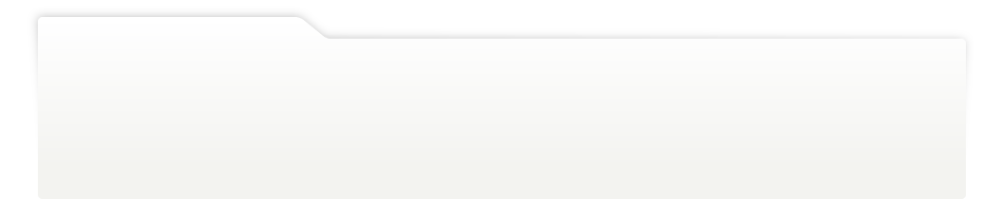
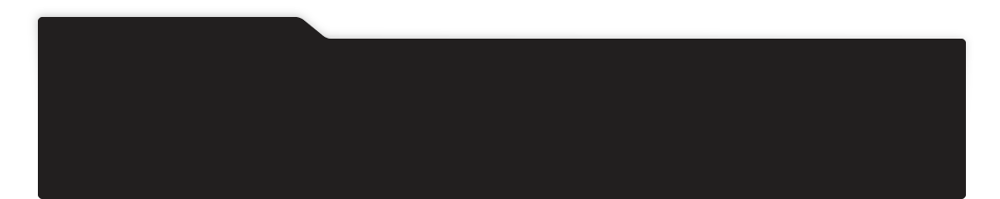
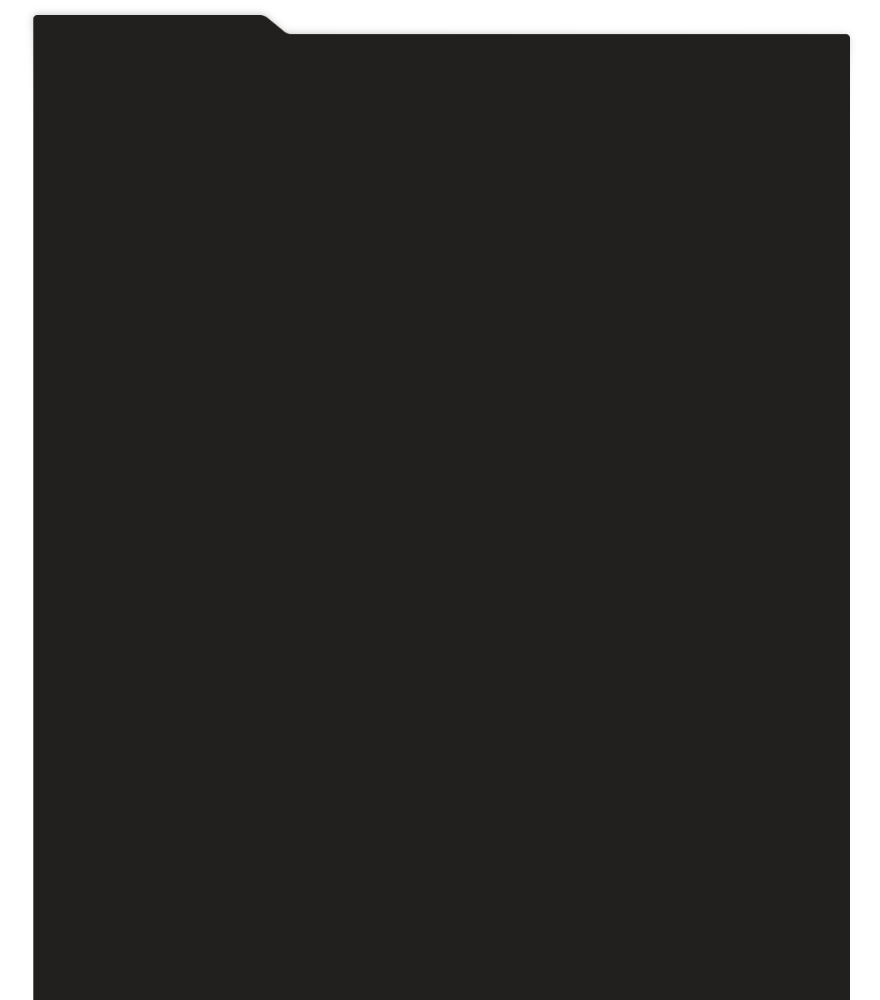
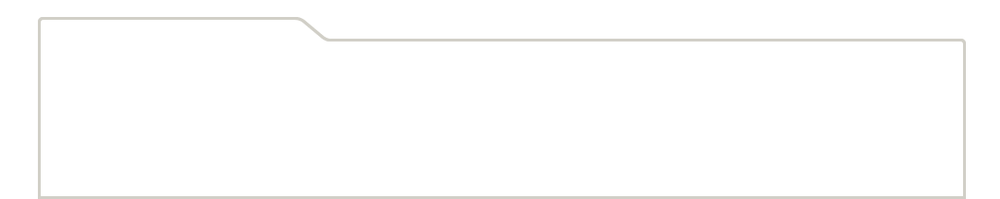
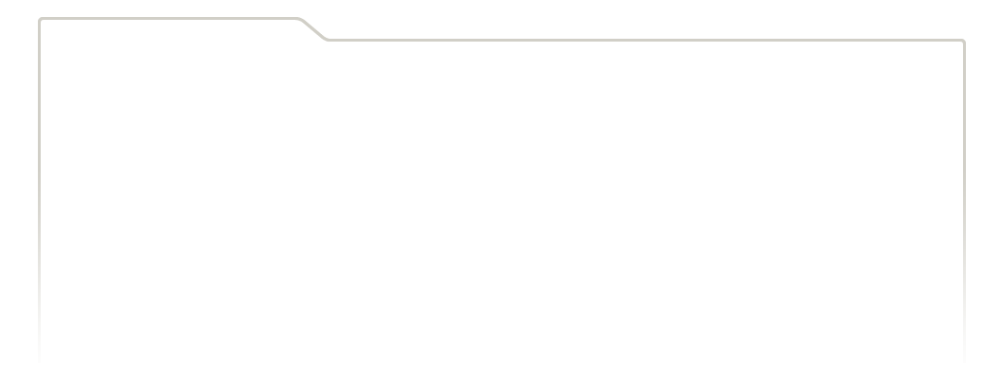
...
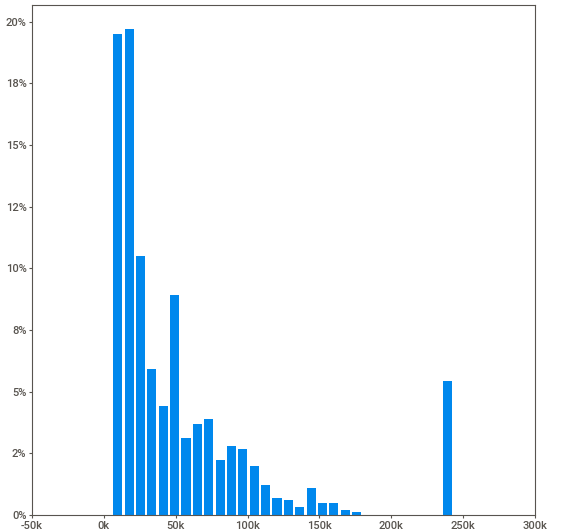
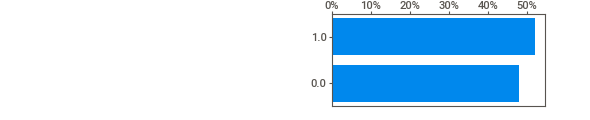
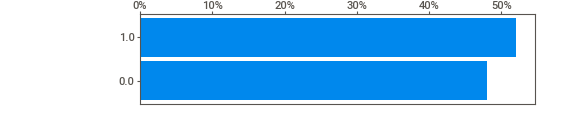
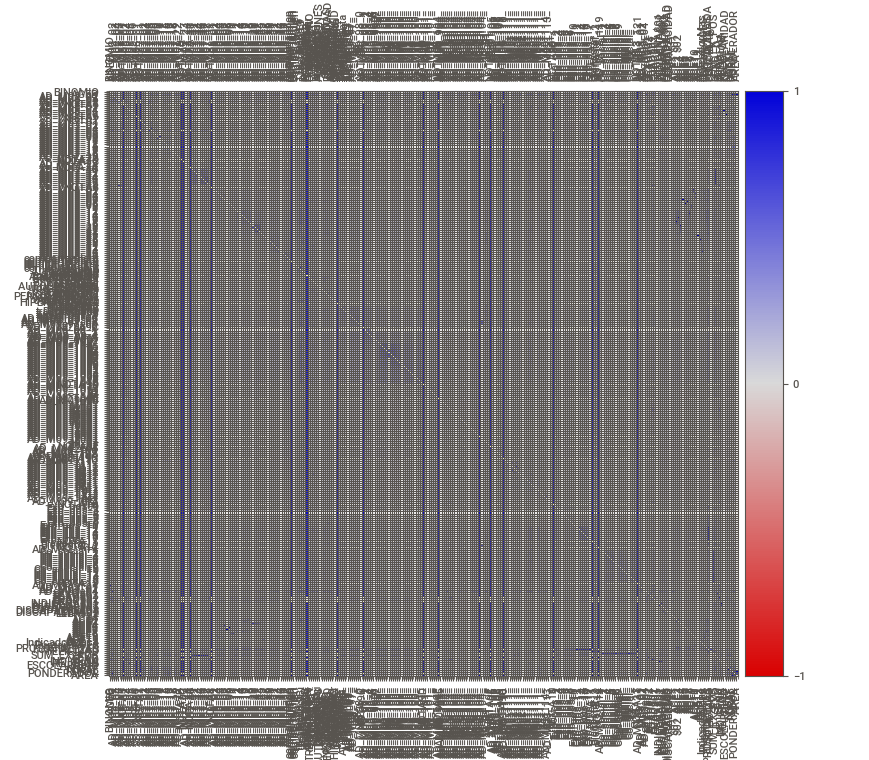
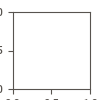

In [ ]:
report_num.show_notebook()

In [ ]:
# Guardamos el reporte en un srchivo html
report_num.show_html('sweetviz_report_full DF.html')

Report sweetviz_report_full DF.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


# Análisis bi-variado

Pretendemos determinar en qué medida es posible predecir el valor de una variable en el caso en que conozcamos el valor de otra. En este caso comparamos el data frame en dos sub-conjuntos, uno para hombres y otro para mujeres y verificamos la relación de las variables con el target "TRANSTORNO_ESTRES POSTRAUMÁTICO".

Vemos algunos comportamientos lógicos, por ejemplo para las categorías de Bienestar hay una relación inversamente proporcional con el target: mientras menor Bienestar hay una mayor relación con la presencia del trastorno.

In [ ]:
# Forzamos algunas categorías para ser consideradas categóricas y numéricas
feature_config = sv.FeatureConfig(force_cat=['SEXO'],force_num='TRANSTORNO_ESTRES POSTRAUMÁTICO')

In [160]:
# Creamos algunos data frames secundarios basados en los tipos de variables

df_test = df_adultos.astype(object)
df_test = df_adultos.select_dtypes(exclude=['object',int])
df_test = df_adultos.select_dtypes(include=[float])


                                             |          | [  0%]   00:00 -> (? left)


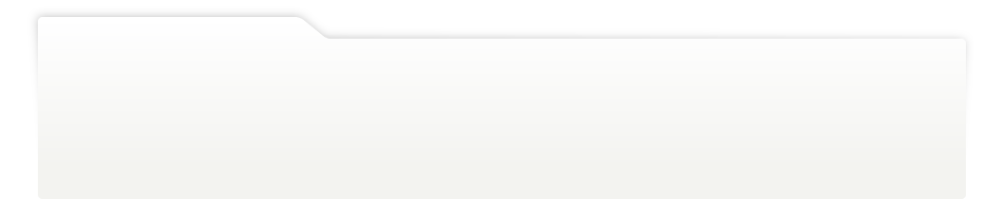
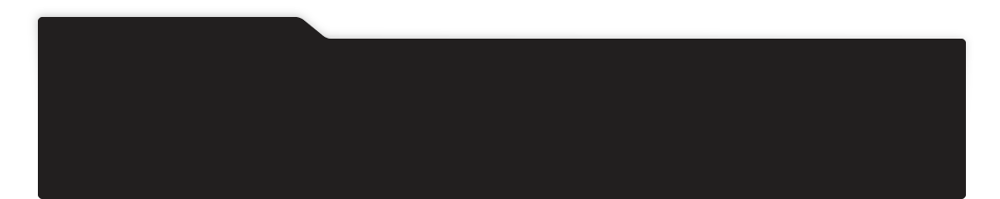
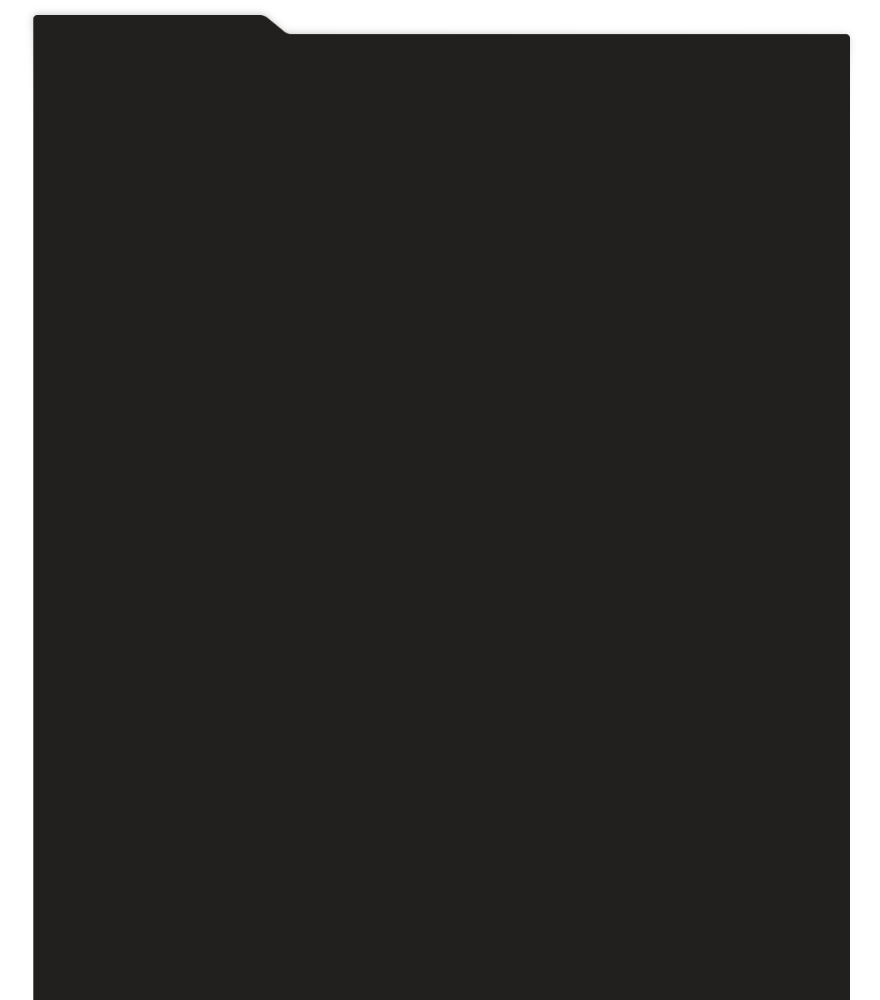
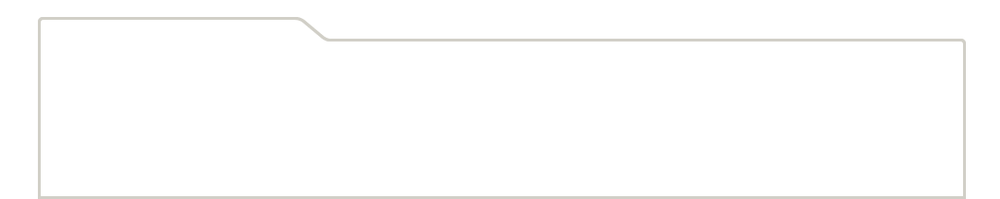
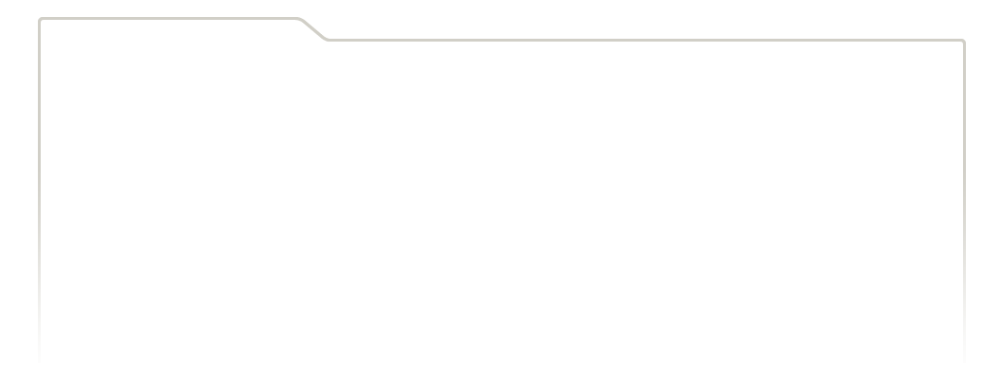
...
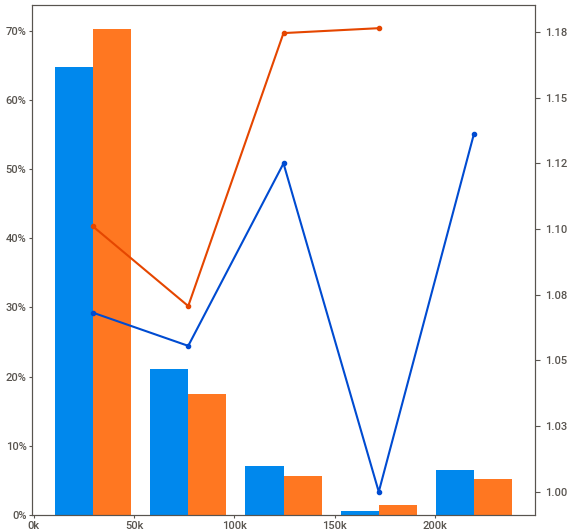
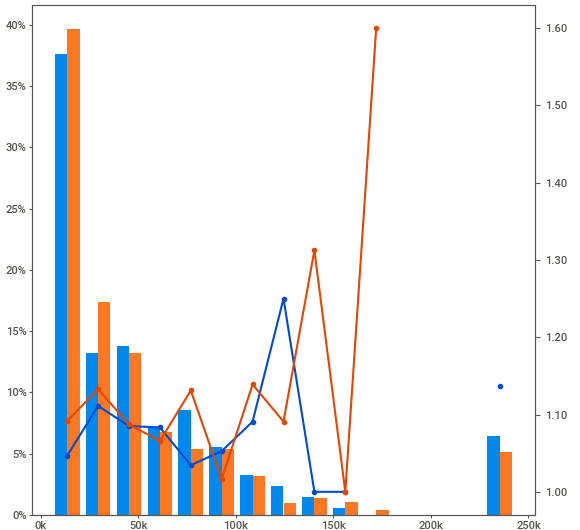
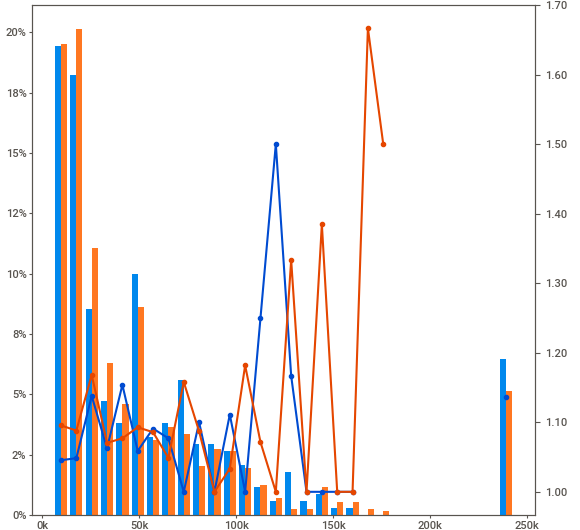
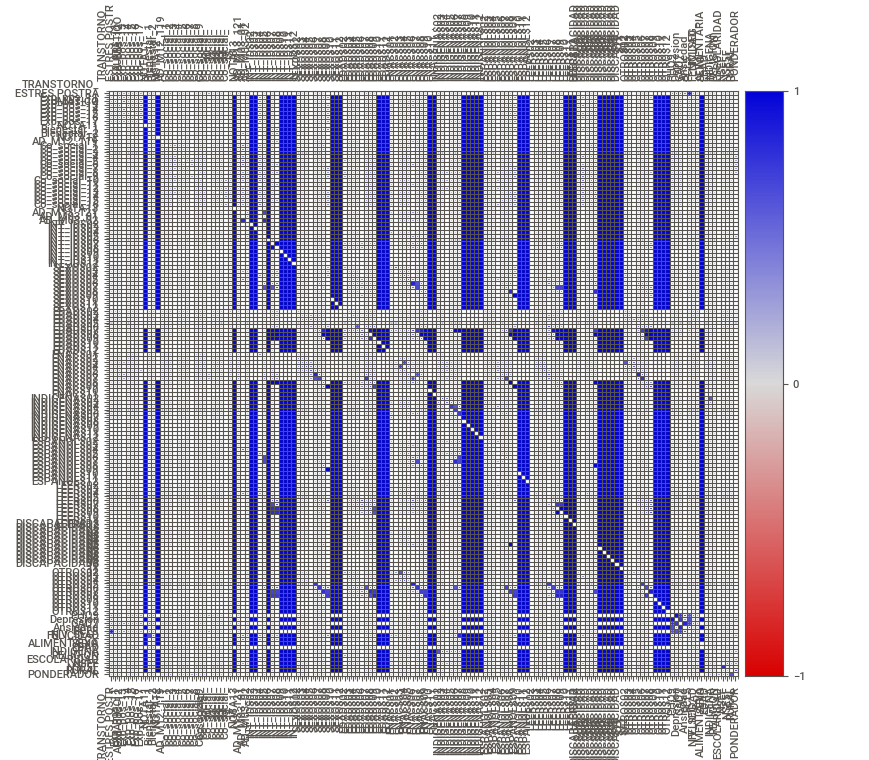
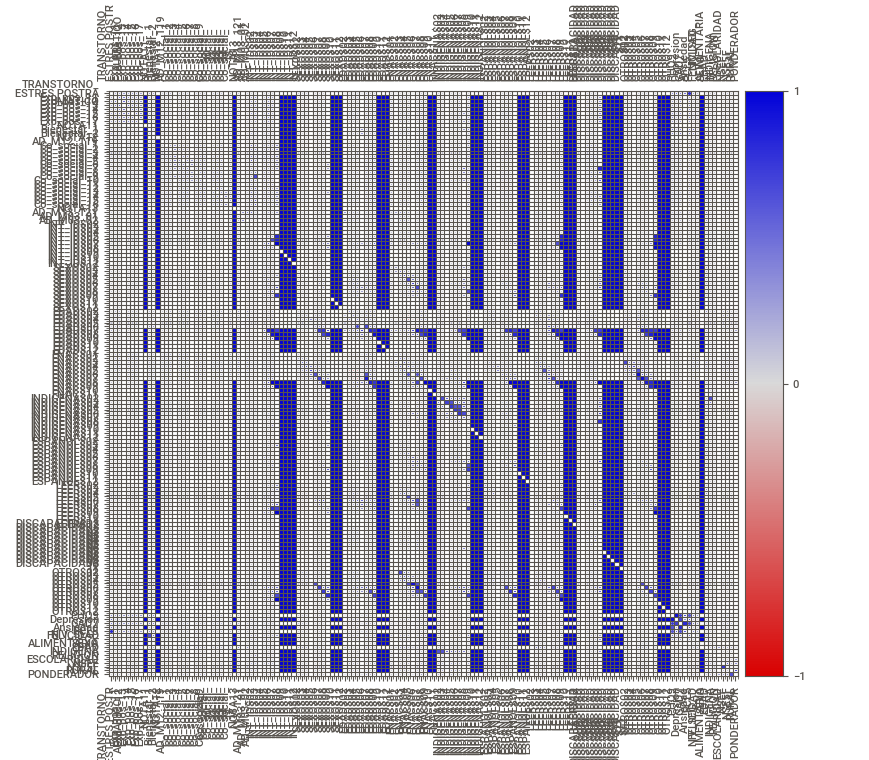

In [ ]:
sweetv_compare_intra = sv.compare_intra(df_test.iloc[:,-150:-1], target_feat='TRANSTORNO_ESTRES POSTRAUMÁTICO', condition_series = df_adultos['SEXO']==1, names=['Hombre','Mujer'],pairwise_analysis='on', feat_cfg = feature_config)

sweetv_compare_intra.show_notebook()

In [ ]:
# Guardamos el reporte en un srchivo html

sweetv_compare_intra.show_html('sweetviz_bi-variate_report_Estrés_Sexo.html')

Report sweetviz_bi-variate_report_Estrés_Sexo.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


# Codificación de datos categóricos

Hacemos este proceso únicamente como preparación para la prueba de dependencia Chi-Square. Para el modelado de los datos estaremos utilizando un pipeline.

In [247]:
# Hacemos una copia del Data Frame obtenido para tener un respaldo rápido

df_adultos2 = df_adultos.copy()

In [248]:
# Creamos listas de variables numéricas y categóricas en todo el data frame para hacer EDA
high_freq_lst = []
low_freq_lst = []
ord_lst = []


for col in df_adultos2:
    if  df_adultos2[col].nunique()>10: # Cuando son vraiables de alta cardinalidad, estaremos usando solamente el valor más común
        high_freq_lst.append(col)
    elif df_adultos2[col].nunique()<=2: # Variables binarias
      low_freq_lst.append(col)
    elif df_adultos2[col].nunique() <= 10: # Variables que deseamos mantener en todas sus categorías, por su valor ordinal.
      ord_lst.append(col)

num_var = df_adultos2[high_freq_lst].select_dtypes(exclude='object').columns # Variables numéricas
bin_var = df_adultos2[low_freq_lst].columns # Variables binarias
cat_var = df_adultos2[high_freq_lst].select_dtypes(include='object').columns # Variables categóricas
ord_var = df_adultos2[ord_lst].columns # Variables ordinales
cat_lst = list(bin_var) + list(cat_var) + list(ord_var)
freq_lst = list(bin_var) + list(cat_var) + list(num_var)

In [249]:
from feature_engine.encoding import OrdinalEncoder

enc = OrdinalEncoder(encoding_method="arbitrary", variables= list(ord_var))

In [250]:
enc.fit(df_adultos2.astype('object'))

OrdinalEncoder(encoding_method='arbitrary',
               variables=['AD_M02_03', 'AD_M05_01', 'AD_M05_02', 'AD_M05_04',
                          'AD_M05_05', 'AD_M05_06', 'AD_M06_01', 'AD_M07_01',
                          'AD_M07_02', 'AD_M07_03', 'AD_M07_04', 'AD_M07_09',
                          'AD_M07_10', 'AD_M07_12', 'AD_M07_13', 'AD_M07_15',
                          'AD_M07_16', 'AD_M07_18', 'AD_M07_22', 'AD_M07_23',
                          'AD_M07_40', 'AD_M07_41', 'AD_M07_42', 'AD_M07_43',
                          'AD_M07_44', 'AD_M07_45', 'AD_M07_46', 'AD_M07_47',
                          'AD_M08_01', 'AD_M08_02', ...])

In [251]:
df_adultos_enc = enc.transform(df_adultos2)

# Codificación de variables de alta cardinalidad

In [252]:
from feature_engine.encoding import OneHotEncoder

ohe_enc = OneHotEncoder(top_categories=1, variables= freq_lst, drop_last_binary=True)

In [253]:
ohe_enc.fit(df_adultos2.astype(object))

OneHotEncoder(drop_last_binary=True, top_categories=1,
              variables=['BINOMIO', 'AD_M02_02', 'AD_M07_06', 'AD_M07_08',
                         'AD_M07_11', 'AD_M07_17', 'AD_M07_19', 'AD_M07_24',
                         'AD_M07_48', 'AD_M08_07', 'AD_M08_08',
                         'comportamiento_riesgo 1', 'comportamiento_riesgo 5',
                         'comportamiento_riesgo 9', 'comportamiento_riesgo 13',
                         'comportamiento_riesgo 17', 'comportamiento_riesgo 21',
                         'De..., 'Trastorno Bipolar_pregunta',
                         'Ezquizofrenia_pregunta', 'Estrés postrauma_pregunta',
                         'Anorexia Nerviosa_pregunta',
                         'Bulimia Nerviosa_pregunta', 'Ansiedad_encuesta',
                         'TRASTORNO_LÍMITE_PERSONALIDAD_pregunta',
                         'Ideación Suicida_pregunta',
                         'AUTOLESIONES NO SUICIDAS_pregunta',
                         'DÉFICIT_ATENCIÓN_HIPERACTIVIDAD_pregunta',
                         'Alcoholismo', 'Consumo_Sustancias_pregunta', ...])

In [254]:
df_adultos_enc = ohe_enc.transform(df_adultos2)

In [255]:
# Usamos OHE para las variables de salida
ohe_enc_target = OneHotEncoder(top_categories=1, variables=list(y.columns),drop_last_binary=False,ignore_format=True)

In [256]:
ohe_enc_target.fit(y.astype(object))

OneHotEncoder(ignore_format=True, top_categories=1,
              variables=['DEPRESION', 'ANSIEDAD',
                         'TRANSTORNO_ESTRES POSTRAUMÁTICO',
                         'SOSPECHA DE ANOREXIA/BULIMIA'])

In [257]:
y_enc = ohe_enc_target.transform(y)

# Filtrado de datos: Chi-Squared Test

In [258]:
from sklearn.feature_selection import chi2

targets = ['Depresion_1.0', 'Ansiedad_1.0',
           'SOSPECHA DE ANOREXIA/BULIMIA_1.0',
           'TRANSTORNO_ESTRES POSTRAUMÁTICO_1.0']

p_value_lst = []
chi_scores_lst = []

for i in range(len(y.columns)):

  chi_scores = chi2(df_adultos_enc, y_enc.iloc[:,i])
  chi_scores_lst.append(chi_scores)


In [259]:
for scores in chi_scores_lst:
  x1, x2 = scores
  p_values = pd.Series(scores[1],index = df_adultos_enc.columns)
  p_value_lst.append(p_values)

In [260]:
# Dejamos en una lista sólo las variables con un valor de significancia estadística
# menor a 0.05 para asegurar la dependencia de las variables de salida con éstas.

filtered_lst =[]

for x in p_value_lst[0]:
  if x <= 0.05:
    filtered_lst.append(p_value_lst[0][p_value_lst[0] == x].index[0])
    #print(x)
filtered_lst = list(set(filtered_lst))

In [261]:
p_values = p_values.sort_values(ascending=False)

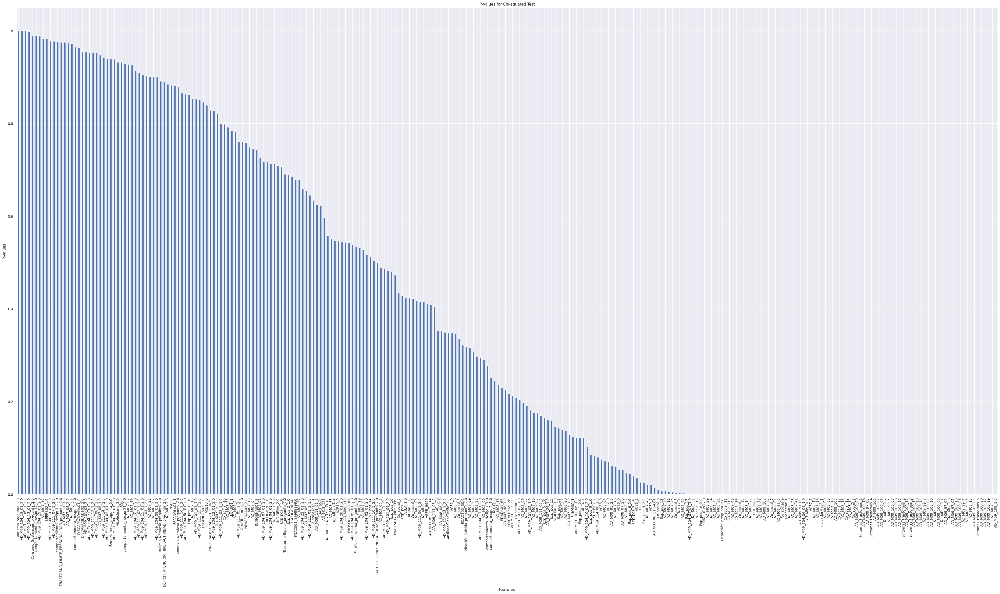

In [262]:
# Create a figure with a specific size
fig, ax = plt.subplots(figsize=(50, 25))

# Plot the p_values for y_train_enc.iloc[:,0] (1st target)
p_values.plot(kind='bar', ax=ax)

# Set labels and title
ax.set_xlabel('Features')
ax.set_ylabel('P-values')
ax.set_title('P-values for Chi-squared Test')

# Show the plot
plt.show()

#p_values.plot.bar()

In [263]:
# Vemos las variables con P-Value <= 0.05

print("Dimensiones de Data Frame antes de prueba Chi-Square: ",df_adultos.shape)
print("Dimensiones de Data Frame después de prueba Chi-Square: ",df_adultos_enc[filtered_lst].shape)

Dimensiones de Data Frame antes de prueba Chi-Square:  (1468, 276)
Dimensiones de Data Frame después de prueba Chi-Square:  (1468, 128)


# Reducción de dimensionalidad - MCA (Multiple Component Analysis)

Utilizamos MCA para representar los datos en un plano de baja dimensionalidad con base en una tabla de contingencia que captura las frecuencias que cada combinación de categorías tiene en nuestro conjunto de datos en una tabla de contigencia para posteriormente aplicar PCA para explicar la mayor varianza posible en el conjunto de datos y que se traduce en información útil para los modelos de clasificación.

In [264]:
import prince

mca = prince.MCA(one_hot=False,n_components=90, random_state=42)
mca_result = mca.fit(df_adultos_enc[filtered_lst])
#mca_result = mca.fit(df_adultos_enc)

In [265]:
# obtain main components
main_comp_X_train = mca_result.eigenvalues_summary
main_comp_X_train

,eigenvalue,% of variance,% of variance (cumulative)
component,,,
0,0.231,9.30%,9.30%
1,0.206,8.30%,17.60%
2,0.173,6.97%,24.57%
3,0.145,5.83%,30.41%
4,0.135,5.46%,35.87%
...,...,...,...
85,0.002,0.09%,98.06%
86,0.002,0.09%,98.15%
87,0.002,0.08%,98.23%


In [266]:
contributions = mca.column_contributions_.style.format('{:.0%}')
contrib_df = pd.DataFrame(contributions.data)
contrib_df = contrib_df.sort_values(ascending=False, by=0)
contrib_df.head()

,0,1,2,3,4,5,6,7,8,9,...,80,81,82,83,84,85,86,87,88,89
AD_M07_23,0.763795,0.158474,0.007519,0.003471,0.000495,0.000264,0.011297,0.001599,0.003419,0.000015,...,9.890504e-07,2.498274e-05,0.000011,3.694023e-06,8.839312e-06,2.616800e-06,9.472521e-08,0.000004,3.554581e-07,0.000004
Co_social_8,0.058653,0.142475,0.027869,0.000552,0.023098,0.000771,0.022773,0.007867,0.060810,0.067037,...,6.206261e-06,1.878074e-05,0.000011,1.659560e-05,1.020388e-06,3.479062e-10,5.368641e-06,0.000001,1.669731e-05,0.000004
Co_social_12,0.038528,0.076959,0.018817,0.000448,0.008959,0.000342,0.003999,0.002685,0.005980,0.005629,...,8.170029e-06,2.795340e-08,0.000041,1.119626e-04,1.905266e-05,5.275945e-05,1.144396e-07,0.000021,6.481764e-06,0.000011
Co_social_15,0.026599,0.051016,0.011103,0.000915,0.006535,0.001290,0.001559,0.000353,0.002858,0.006797,...,2.655253e-07,8.116276e-07,0.000016,3.057107e-06,6.962534e-07,8.014847e-05,3.695675e-05,0.000021,6.671154e-06,0.000028
Co_social_16,0.025438,0.062508,0.011468,0.000331,0.004249,0.000042,0.002158,0.000004,0.007016,0.019814,...,4.393902e-05,3.860931e-05,0.000001,3.152796e-07,1.775459e-06,2.232857e-08,1.135029e-07,0.000019,2.716264e-05,0.000004


In [267]:
contrib_df.to_csv('OHE_5comp_X_train_enc v6.csv')

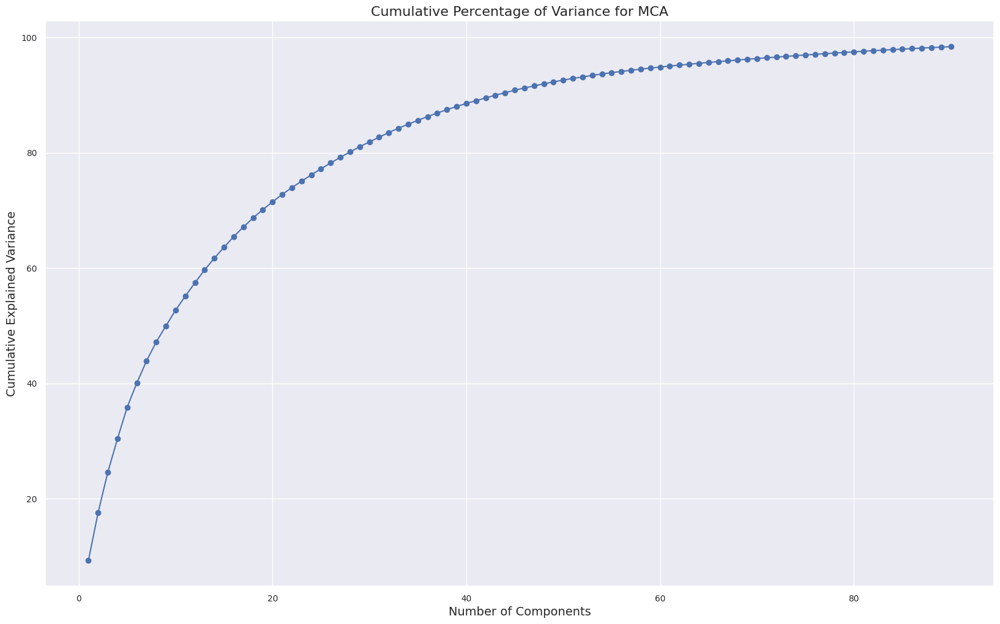

In [274]:
import matplotlib.pyplot as plt

# Create a figure with a specific size
fig, ax = plt.subplots(figsize=(20, 12))

# Plot the p_values for y_train_enc.iloc[:,0] (1st target)
#p_values.plot(kind='bar', ax=ax)

# Set labels and title
#ax.set_xlabel('Number of Components')
#ax.set_ylabel('P-values')
#ax.set_title('P-values for Chi-squared Test')
cumsum= mca.cumulative_percentage_of_variance_
cumulative_var = mca.cumulative_percentage_of_variance_
plt.plot(range(1, len(cumulative_var) + 1), cumulative_var, marker='o')
plt.xlabel('Number of Components',fontsize=14)
plt.ylabel('Cumulative Explained Variance',fontsize=14)
plt.title('Cumulative Percentage of Variance for MCA', fontsize=16)
plt.show()

In [ ]:
mca.plot(
    df_adultos_enc,
        x_component=0,
    y_component=2,
    show_column_markers=True,
    show_row_markers=True,
    show_column_labels=False,
    show_row_labels=False
)

alt.LayerChart(...)

In [288]:
# Seleccionamos variables de nuestro Data Frame con un % deseado de variabilidad acumulada

cumulative_percent_threshold = 0.996
cumulative_sum = 0
selected_variables = []

for x in contrib_df:
# Sorting values in descending order
  sorted_column =contrib_df[x].sort_values(ascending=False)

for variable, value in sorted_column.items():
    cumulative_sum += float(value)
    selected_variables.append(variable)

    if cumulative_sum >= cumulative_percent_threshold:
        break
print(len(list(set(selected_variables))))


64


In [292]:
# Como la lista generada tiene algunos nombres afectados por la codificación,
# verificamos aquellas que no están presentes en nuestra lista

miss_ele = []
new_lst=[]

selected_variables = list(set(selected_variables))

for i in selected_variables:
  if i in df_adultos2:
    new_lst.append(i)
  else:
    new_lst.extend(list(df_adultos.columns[df_adultos2.columns.str.contains(i[:-2], regex=False)]))

for i in selected_variables:
  if i not in new_lst:
    miss_ele.append(i)

#Agregamos algunas variables numéricas, en caso de que hayan sido eliminadas

added_ele = ['FORTALEZAS','SUM_EX_POS', 'PONDERADOR', 'PROSOCIALIDAD']

new_lst += list(filter(lambda x: x not in new_lst, added_ele))

print(len(list(set(new_lst)))) # Verificamos nuestro número final

55


In [293]:
# Vemos la reducción en la dimensionalidad

#df_adultos_new = df_adultos_enc[selected_variables]
df_adultos_new = df_adultos2[new_lst]

print("Dimensiones de variables antes de MCA: ",df_adultos.shape)
print("Dimensiones de variables después de MCA: ",df_adultos_new.shape)
#print("Dimensiones de variables después de MCA: ",df_adultos_enc[selected_variables].shape)


Dimensiones de variables antes de MCA:  (1468, 276)
Dimensiones de variables después de MCA:  (1468, 55)


In [294]:
y_data = y.copy()


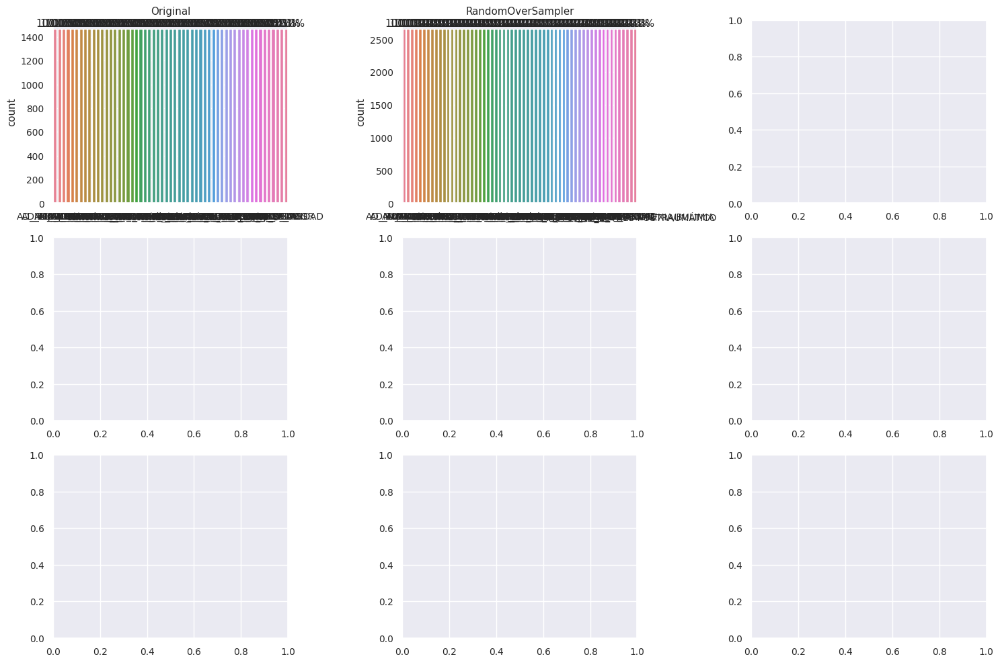

In [295]:
# balancing the dataset

models = [

    ('Original', df_adultos_new),

   # ('RandomUnderSampler', RandomUnderSampler(sampling_strategy='auto')),

    #('TomekLinks', TomekLinks(sampling_strategy='auto')),

#    ('EditedNearestNeighbours', EditedNearestNeighbours(sampling_strategy='auto')),

    ('RandomOverSampler', RandomOverSampler(sampling_strategy='auto')),

 #   ('SMOTE', SMOTE(sampling_strategy='auto')),

  #  ('SMOTEENN', SMOTEENN(sampling_strategy='auto')),

   # ('SMOTETomek', SMOTETomek(sampling_strategy='auto')),

]



fig, ax = plt.subplots(3, 3, figsize=(15, 10))

ax = ax.ravel()



for i, (name, model) in enumerate(models):

    if name == 'Original':

        data = df_adultos_new

    else:

        data = df_adultos_new.copy()



        # fit the model

        Xr, y1 = model.fit_resample(data, y_data['TRANSTORNO_ESTRES POSTRAUMÁTICO'])
     #   Xr, y2 = model.fit_resample(data, y_data['SOSPECHA DE ANOREXIA/BULIMIA'])
     #   Xr, y3 = model.fit_resample(data, y_data['Depresion'])
      #  Xr, y1 = model.fit_resample(data, y_data['Ansiedad'])
        data = pd.concat([Xr, y1, y_data[['DEPRESION','ANSIEDAD', 'SOSPECHA DE ANOREXIA/BULIMIA']]], axis=1)



    sns.countplot(data=data, ax=ax[i])

    # annotate percentage

    total = len(data)

    for p in ax[i].patches:

        percentage = '{:.1f}%'.format(100 * p.get_height() / total)

        x_new = p.get_x() + p.get_width() / 2

        y_new = p.get_height()

        ax[i].annotate(percentage, (x_new, y_new), ha='center', va='bottom')

    ax[i].set_title(name)



plt.tight_layout()

plt.show()



In [296]:
rs_y = data[['DEPRESION',	'ANSIEDAD','TRANSTORNO_ESTRES POSTRAUMÁTICO', 'SOSPECHA DE ANOREXIA/BULIMIA']]
data.drop(columns=['DEPRESION',	'ANSIEDAD','TRANSTORNO_ESTRES POSTRAUMÁTICO', 'SOSPECHA DE ANOREXIA/BULIMIA'], inplace=True)

In [297]:
# Hacemos un conteo de las variables únicas por conjunto de datos
print('Tabla de categorías únicas por variablede entrada \n')
tabla =[]
for x in data:
#  print(f'{x}: {data[x].nunique()}')

  tabla.append([x, data[x].nunique()])

print(tabulate(list(tabla),
        headers=["Variable", 'Categorías únicas'],
        tablefmt="github",
        floatfmt=".2f"
        ) ,'\n')



Tabla de categorías únicas por variablede entrada 

| Variable              |   Categorías únicas |
|-----------------------|---------------------|
| AD_M09_100_06         |                   5 |
| AD_M09_100_05         |                   5 |
| Exp_pos_13            |                   7 |
| ACE8                  |                   2 |
| AD_M09_100_02         |                   5 |
| AD_M09_100_18         |                   5 |
| AD_M09_99_1           |                   4 |
| AD_M09_100_15         |                   5 |
| AD_M09_100_20         |                   5 |
| AD_M09_100_01         |                   5 |
| AD_M07_40             |                   3 |
| AD_M09_97_07          |                   4 |
| FELICIDAD             |                   9 |
| AD_M09_100_04         |                   5 |
| Bienestar_1           |                   6 |
| Síntomas_trastornos_1 |                   4 |
| Síntomas_trastornos_2 |                   4 |
| AD_M09_99_3           |           

In [298]:
# Hacemos un conteo de los elementos por categoría en las clases de salida,
# Vemos que ahora la categoría TRANSTORNO_ESTRES POSTRAUMÁTICO está balanceada
for col in rs_y:
  print(rs_y[col].value_counts())

1.0    978
2.0    334
3.0    100
4.0     33
5.0     23
Name: DEPRESION, dtype: int64
1.0    1031
2.0     300
3.0      89
4.0      48
Name: ANSIEDAD, dtype: int64
1.0    1331
2.0    1331
Name: TRANSTORNO_ESTRES POSTRAUMÁTICO, dtype: int64
1.0    1104
2.0     364
Name: SOSPECHA DE ANOREXIA/BULIMIA, dtype: int64


In [299]:
# Definimos nuestros conjuntos de entrenamiento, prueba y validación
X_train, X_test, y_train, y_test = train_test_split(data, rs_y, test_size=0.3, random_state=0, shuffle=True)
#X_train, X_test, y_train, y_test = train_test_split(df_adultos_new, y, test_size=0.3, random_state=0, shuffle=True)

In [300]:
# Creamos listas de variables numéricas y categóricas
high_freq_lst = []
low_freq_lst = []
ord_lst = []


for col in X_train:
    if  X_train[col].nunique()>10:
        high_freq_lst.append(col)
    elif X_train[col].nunique()<=2:
      low_freq_lst.append(col)
    elif 2 < X_train[col].nunique() <= 10:
      ord_lst.append(col)

num_var = X_train[high_freq_lst].select_dtypes(exclude='object').columns # Variables numéricas
bin_var = X_train[low_freq_lst].columns # Variables binarias
cat_var = X_train[high_freq_lst].select_dtypes(include='object').columns # Variables categóricas
ord_var = X_train[ord_lst].columns # Variables ordinales
freq_lst = list(cat_var) + list(num_var)

In [301]:
# Transformaciones a factores numéricos de entrada:

ord_pipeline = Pipeline(steps = [('impModa', SimpleImputer(strategy='most_frequent')),
                                 ('ord_Enc', OrdinalEncoder(encoding_method="arbitrary", ignore_format=True))
                                 ])

high_freq_pipeline = Pipeline(steps = [('impModa', SimpleImputer(strategy='most_frequent')),
                                  ('highfreq_Enc', OneHotEncoder(top_categories=1, ignore_format=True, drop_last_binary=True)),
                                 ])
low_freq_pipeline = Pipeline(steps = [('impModa', SimpleImputer(strategy='most_frequent')),
                                  ('lowfreq_Enc', OneHotEncoder(top_categories=1, ignore_format=True, drop_last_binary=True)),
                                 ])

num_pipeline = Pipeline(steps = [('impMedian', SimpleImputer(strategy='median')),
                                 ('switch_values', FunctionTransformer(lambda x: x+1, validate=False)),
                                  ('boxcox', PowerTransformer(method='box-cox',standardize=True)),
                                 ('escalaCat', MinMaxScaler(feature_range=(0,1)))
                                 ])


ord_pipeline_nombres = ord_lst
high_freq_nombres = num_var
low_freq_nombres = low_freq_lst
num_nombres = num_var

# Conjuntamos las transformaciones numéricas que se estarán aplicando a los datos de entrada:
columnasTransformerX = ColumnTransformer(transformers = [('ordpipe', ord_pipeline, ord_pipeline_nombres),
                                                        #('highfreqpipe', high_freq_pipeline, high_freq_nombres),
                                                         ('lowfreqpipe', low_freq_pipeline, low_freq_nombres),
                                                         ('numpipe', num_pipeline, num_nombres)],
                                        remainder='passthrough')

In [305]:

# Transformaciones a variables de salida:
y_pipeline = Pipeline(steps = [('impModa', SimpleImputer(strategy='most_frequent')),
                              ('freq_Enc', OneHotEncoder(top_categories=1, drop_last_binary=True)),
                                #('escalaCat', MinMaxScaler(feature_range=(0,1))),
                             #  ('switch_values', FunctionTransformer(lambda x: 1 - x, validate=False))
                                ])
y_pipeline_nombres = y_train.columns

# Conjuntamos las transformaciones numéricas que se estarán aplicando a los datos de entrada:
columnasTransformerY = ColumnTransformer(transformers = [('ypipe', y_pipeline, y_pipeline_nombres)],
                                      remainder='passthrough')

In [306]:
# Verificamos que en los datos transformados no haya valores faltantes
transformed_Y = columnasTransformerY.fit_transform(y_train.astype('object'))
Ytransformed_df = pd.DataFrame(transformed_Y, columns=list(y_train.columns))
Ytransformed_df.isnull().mean()

DEPRESION                          0.0
ANSIEDAD                           0.0
TRANSTORNO_ESTRES POSTRAUMÁTICO    0.0
SOSPECHA DE ANOREXIA/BULIMIA       0.0
dtype: float64

In [307]:
# Hacemos lo mismo con los datos de salida
ytestTransf = columnasTransformerY.fit_transform(y_test.astype('object'))
ytestTransf_df = pd.DataFrame(ytestTransf, columns=list(y_test.columns))
ytestTransf_df.isnull().mean()

DEPRESION                          0.0
ANSIEDAD                           0.0
TRANSTORNO_ESTRES POSTRAUMÁTICO    0.0
SOSPECHA DE ANOREXIA/BULIMIA       0.0
dtype: float64

# Modelos de clasificación

Utilizamos modelos de clasificación binaria sobre cada una de las variables de salida de manera independiente, es decir, en este punto no estamos obteniendo resultados simultáneamente sobre todos los padecimientos en cada predicción a manera de obtener un baseline que nos permita un ajuste fino posterior. Para este fin al hacer OHE sobre las categoría de mayor frecuencia, nos permitió reflejar si el diagnóstico fue positivo o negativo, independientemente de la severidad del padecimiento.

In [308]:
import warnings
warnings.filterwarnings("ignore")

In [309]:
# Utilizaremos todo el conjunto de datos para Validación Cruzada
X = data
y = rs_y

In [ ]:
# Probamos con los modelos individuales baseline

from sklearn import metrics

# Seleccionamos primeramente nuestro modelo de aprendizaje automático, en este caso el de regresión lineal múltiple:
#modelo_LR = LogisticRegression(max_iter=1000)

models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Decision Tree": DecisionTreeClassifier(),
    "Support Vector Machine": SVC(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Sochastic Gradient Descent": SGDClassifier(),
    "Gaussian Naive Bayes": GaussianNB()

}

precisionTrain = []
precisionVal = []
recallTrain = []
recallVal = []
f1Train = []
f1Val = []

# Inicializamos validación-cruzada usando KFold con k=n_splits particiones.
# Estamos aleatorizando los registros (con el argumento shuffle), ya que no sabemos si los
# datos originales fueron guardados en los archivos con algún patrón particular.

k = 5  # total de particiones (folds)
kf = KFold(n_splits= k, shuffle=True)

# Aplicamos validación-cruzada mediante la evaluación de cada una de las k particiones:
for train_index, val_index in kf.split(X):
  for name,model in models.items():
    for i in range(len(y.columns)):

      # En cada partición definimos ahora sí el conjunto de entrenamiento y el de validación:
      Xtrain, X_val = X.iloc[train_index,:], X.iloc[val_index,:]
      ytrain, y_val = y.iloc[train_index,:], y.iloc[val_index,:]

      # Aplicamos las transformaciones al conjunto de entrenamiento:
      XtrainFit = columnasTransformerX.fit(X.astype('object'))   # Generamos la información necesaria con el conjunto de entrenamiento.
      ytrainFit = columnasTransformerY.fit(y.astype('object'))
      XtrainTransf = XtrainFit.transform(Xtrain)    # y aplicamos dichas transformaciones al conjunto de entrenamiento,
      ytrainTransf = ytrainFit.transform(ytrain)
      XvalTransf  =  XtrainFit.transform(X_val)
      yvalTransf  =  ytrainFit.transform(y_val)      # y al conjunto de validación.

      presicion_train = cross_val_score(model, XtrainTransf, ytrainTransf.reshape(4,ytrainTransf.shape[0])[i], cv=5, scoring='precision',)
      presicion_val = cross_val_score(model, XvalTransf , yvalTransf.reshape(4,yvalTransf.shape[0])[i], cv=5, scoring='precision')
      recall_train = cross_val_score(model, XtrainTransf, ytrainTransf.reshape(4,ytrainTransf.shape[0])[i], cv=5, scoring='recall',)
      recall_val = cross_val_score(model, XvalTransf , yvalTransf.reshape(4,yvalTransf.shape[0])[i], cv=5, scoring='recall')
      f1_train = cross_val_score(model, XtrainTransf, ytrainTransf.reshape(4,ytrainTransf.shape[0])[i], cv=5, scoring='f1',)
      f1_val = cross_val_score(model, XvalTransf , yvalTransf.reshape(4,yvalTransf.shape[0])[i], cv=5, scoring='f1')


  # guardamos el desempeño de los diferentes modelos con los datos de entrenamiento.
  # en este caso hay filtración de datos ya que "score" hace aquí uso de del promedio de y_val.

      precisionTrain.append(presicion_train)
      precisionVal.append(presicion_val)
      recallTrain.append(recall_train)
      recallVal.append(recall_val)
      f1Train.append(f1_train)
      f1Val.append(f1_val)


In [ ]:
# Despleguemos los resultados de los diferentes coeficientes de determinación obtenidos:
#names = ['Modelo','target', 'Precisionval','Precisiontrain','Recallval','Recalltrain','f1val','f1train']

print('Promedios de Precisión por Validación Cruzada', '\n')
names=["Model", "Target","PrecisionTrain(mean)","PrecisionVal(mean)",
          "RecallTrain(mean)", "RecallVal(mean)",
          "F1Train(mean)","F1Val(mean)"]
tabla=[]
scores = ['precision', 'recall', 'f1']
targets = ['Depresion', 'Ansiedad', 'ESTRES POSTRAUMA','ANOREXIA/BULIMIA']

# 120 arrays & 5 partitions
# 20 arrays per model (6 models x 20 arrays = 120 arrays)
# 5 arrays per target (4 targets x 5 = 20)


for x in range(len(list(models.keys()))):
  i = x*20
  for n in range(len(y_train.columns)):
    idx = n*4+i
    tabla.append([list(models.keys())[x], y_train.columns[n],np.mean(precisionTrain[idx:idx+4]),
                  np.mean(precisionVal[idx:idx+4]),np.mean(recallTrain[idx:idx+4]),
                  np.mean(recallVal[idx:idx+4]), np.mean(f1Train[idx:idx+4]),
                  np.mean(f1Val[idx:idx+4])])

print(tabulate(list(tabla)[-50:],
          headers=["Model", "Target","PrecisionTrain(mean)","PrecisionVal(mean)",
                    "RecallTrain(mean)", "RecallVal(mean)",
                    "F1Train(mean)","F1Val(mean)"],
          tablefmt="github",
          floatfmt=".2f"
          ) ,'\n')



Promedios de Precisión por Validación Cruzada 

| Model                      | Target                          |   PrecisionTrain(mean) |   PrecisionVal(mean) |   RecallTrain(mean) |   RecallVal(mean) |   F1Train(mean) |   F1Val(mean) |
|----------------------------|---------------------------------|------------------------|----------------------|---------------------|-------------------|-----------------|---------------|
| Logistic Regression        | Depresion                       |                   0.63 |                 0.61 |                0.90 |              0.76 |            0.74 |          0.68 |
| Logistic Regression        | Ansiedad                        |                   0.64 |                 0.61 |                0.61 |              0.58 |            0.62 |          0.60 |
| Logistic Regression        | TRANSTORNO_ESTRES POSTRAUMÁTICO |                   0.63 |                 0.61 |                1.00 |              0.95 |            0.77 |          0.74 |
| Logis

# Estrategia Stacking

In [ ]:
def Stacking(model,train,y,test,n_fold,ytest):
  folds=KFold(n_splits=5, shuffle=True)
  test_pred=[]
  train_pred=[]

  XFit = columnasTransformerX.fit(train.astype('object'))
  Xft = XFit.transform(train)
  Xtransformed_df = pd.DataFrame(Xft, columns=list(new_lst))   # Generamos la información necesaria con el conjunto de entrenamiento.
  yFit = columnasTransformerY.fit(y.astype('object'))
  yft = yFit.transform(y)
  Ytransformed_df = pd.DataFrame(yft, columns=list(y.columns))
  XtestTransf =  XFit.transform(test)
  ytestTransf =  yFit.transform(ytest)

  for train_indices,val_indices in folds.split(Xtransformed_df,Ytransformed_df):
    XtrainTransf,XvalTransf  = Xtransformed_df.iloc[train_indices,:],Xtransformed_df.iloc[val_indices,:]
    ytrainTransf,yvalTransf = Ytransformed_df.iloc[train_indices,0],Ytransformed_df.iloc[val_indices,0]

    model.fit(X=XtrainTransf,y=np.array(ytrainTransf).reshape(-4,ytrainTransf.shape[0])[0,:])
    train_pred = model.predict(XtrainTransf)
    test_pred = model.predict(XtestTransf)

  return test_pred, train_pred, ytrainTransf, XtrainTransf, XtestTransf, ytestTransf

In [ ]:
from sklearn.datasets import make_classification
from sklearn.multioutput import MultiOutputClassifier
from sklearn.ensemble import RandomForestClassifier

model1 = DecisionTreeClassifier(random_state=1)
test_pred1 ,train_pred1, ytrainTransf, XtrainTransf, XtestTransf, ytestTransf =Stacking(model=model1, n_fold=4, train=X, test=X_test, y=y, ytest=y_test)

train_pred1=pd.DataFrame(train_pred1)
test_pred1=pd.DataFrame(test_pred1)#, columns=y.columns[0])

In [ ]:

model2 = SVC()

test_pred2 ,train_pred2, ytrainTransf, XtrainTransf, XtestTransf, ytestTransf = Stacking(model=model2, n_fold=4, train=X, test=X_test, y=y, ytest=y_test)

train_pred2=pd.DataFrame(train_pred2)
test_pred2=pd.DataFrame(test_pred2)#, columns=y.columns)

In [ ]:
df = pd.concat([train_pred1, train_pred2], axis=1)
df_test = pd.concat([test_pred1, test_pred2], axis=1)

model = LogisticRegression()
model.fit(df, ytrainTransf)#.reshape(-1,ytrainTransf.shape[0])[0,:])
score = model.score(df_test, ytestTransf.reshape(-4,ytestTransf.shape[0])[0,:])
print(f'{score:.2f}')

0.57


# Voting Classifier

In [ ]:
from sklearn.ensemble import RandomForestClassifier, VotingClassifier


voting_clf = VotingClassifier(
    estimators=[
        ('lr', LogisticRegression(random_state=42)),
        ('rf', RandomForestClassifier(random_state=42)),
        ('svc', SVC(random_state=42))
    ]
)
voting_clf.fit(Xtransformed_df, Ytransformed_df['Ansiedad'])

VotingClassifier(estimators=[('lr', LogisticRegression(random_state=42)),
                             ('rf', RandomForestClassifier(random_state=42)),
                             ('svc', SVC(random_state=42))])

In [ ]:
for name, clf in voting_clf.named_estimators_.items():
  for i in range(len(y.columns)):
    print(f'{name} for {y.columns[i]}: {clf.score(XvalTransf, yvalTransf[:,i]):.2f}')

lr for Depresion: 0.82
lr for Ansiedad: 0.81
lr for TRANSTORNO_ESTRES POSTRAUMÁTICO: 0.71
lr for SOSPECHA DE ANOREXIA/BULIMIA: 0.33
rf for Depresion: 0.43
rf for Ansiedad: 0.38
rf for TRANSTORNO_ESTRES POSTRAUMÁTICO: 0.26
rf for SOSPECHA DE ANOREXIA/BULIMIA: 0.70
svc for Depresion: 0.79
svc for Ansiedad: 0.76
svc for TRANSTORNO_ESTRES POSTRAUMÁTICO: 0.65
svc for SOSPECHA DE ANOREXIA/BULIMIA: 0.39


# Estrategias Blending

In [ ]:

bag_clf = BaggingClassifier(DecisionTreeClassifier(), n_estimators=500,
                            oob_score=True,
                            max_samples=100, n_jobs=-1, random_state=42)
bag_clf.fit(XtrainTransf, ytrainTransf[:,0])

BaggingClassifier(estimator=DecisionTreeClassifier(), max_samples=100,
                  n_estimators=500, n_jobs=-1, oob_score=True, random_state=42)

In [ ]:
for i in range(len(y.columns)):
  bag_clf.fit(XtrainTransf, ytrainTransf[:,i])
  score = bag_clf.oob_score_
  print(f'Exactitud para {y.columns[i]}: {score:.2f}')

Exactitud para Depresion: 0.93
Exactitud para Ansiedad: 0.91
Exactitud para TRANSTORNO_ESTRES POSTRAUMÁTICO: 0.96
Exactitud para SOSPECHA DE ANOREXIA/BULIMIA: 0.86


In [ ]:
for i in range(len(y.columns)):
  y_pred = bag_clf.predict(XvalTransf)
  precision = precision_score(yvalTransf[:,i], y_pred, average='weighted')
  print(f'Presicion for {y.columns[i]} : {precision:.2f}')

Presicion for Depresion : 0.42
Presicion for Ansiedad : 0.51
Presicion for TRANSTORNO_ESTRES POSTRAUMÁTICO : 0.76
Presicion for SOSPECHA DE ANOREXIA/BULIMIA : 0.89


# RandomForestClassifier

In [ ]:
rnd_clf = RandomForestClassifier(n_estimators=500, max_leaf_nodes=16,
                                 n_jobs=-1, random_state=42)
rnd_clf.fit(XtrainTransf, ytrainTransf)

y_pred_rf = rnd_clf.predict(XvalTransf)

In [ ]:
for i in range(len(y.columns)):
  y_pred = rnd_clf.predict(XvalTransf)
  precision = precision_score(yvalTransf[:,i], y_pred[:,i])
  print(f'Presicion for {y.columns[i]} : {precision:.2f}')

Presicion for Depresion : 0.96
Presicion for Ansiedad : 0.93
Presicion for TRANSTORNO_ESTRES POSTRAUMÁTICO : 0.96
Presicion for SOSPECHA DE ANOREXIA/BULIMIA : 0.26


In [ ]:
for score, name in zip(rnd_clf.feature_importances_.argsort()[-10:][::-1], X_train.columns):
  print(round(score, 2), name)

6 AD_M07_45
25 NSEF
32 Síntomas_trastornos_4
12 AD_M08_27
28 ACE7
17 AD_M09_100_09
16 AD_M05_02
11 AD_M09_97_06
27 AD_M09_100_10
8 SUM_EX_POS


# AdaBoostClassifier

In [ ]:
from sklearn.ensemble import AdaBoostClassifier

ada_clf = AdaBoostClassifier(
    DecisionTreeClassifier(max_depth=3), n_estimators=30,
    learning_rate=0.001, random_state=42)
ada_clf.fit(XtrainTransf, ytrainTransf[:,0])

AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=3),
                   learning_rate=0.001, n_estimators=30, random_state=42)

In [ ]:
for i in range(len(y.columns)):
  y_pred = ada_clf.predict(XvalTransf)
  precision = precision_score(yvalTransf[:,i], y_pred, average='weighted')
  print(f'Presicion for {y.columns[i]} : {precision:.2f}')

Presicion for Depresion : 0.89
Presicion for Ansiedad : 0.78
Presicion for TRANSTORNO_ESTRES POSTRAUMÁTICO : 0.90
Presicion for SOSPECHA DE ANOREXIA/BULIMIA : 0.54


In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

model_GBC= GradientBoostingClassifier(learning_rate=0.01,random_state=1)
model_GBC.fit(XtrainTransf, ytrainTransf[:,0])
model_GBC.score(XtestTransf,ytestTransf[:,0])

0.9229024943310657

In [ ]:
for i in range(len(y.columns)):
  y_pred = model_GBC.predict(XvalTransf)
  precision = precision_score(yvalTransf[:,i], y_pred, average='weighted')
  accuracy = accuracy_score(yvalTransf[:,i], y_pred)
  print(f'Presicion for {y.columns[i]} : {precision:.2f}')
  print(f'Accuracy for {y.columns[i]} : {accuracy:.2f}')

Presicion for Depresion : 0.89
Accuracy for Depresion : 0.88
Presicion for Ansiedad : 0.78
Accuracy for Ansiedad : 0.72
Presicion for TRANSTORNO_ESTRES POSTRAUMÁTICO : 0.90
Accuracy for TRANSTORNO_ESTRES POSTRAUMÁTICO : 0.65
Presicion for SOSPECHA DE ANOREXIA/BULIMIA : 0.54
Accuracy for SOSPECHA DE ANOREXIA/BULIMIA : 0.36


# Búsqueda de parámetros óptimos para los mejores modelos


In [ ]:
# Bagging Classifier

bag_pipe = Pipeline(steps=[('col_transformer', columnasTransformerX),
                          ('imputer',SimpleImputer(strategy='most_frequent')),
                          ('model',BaggingClassifier(DecisionTreeClassifier()))])

params = {#'base_estimator__parameter' : [1,2],
          'model__base_estimator__class_weight':['balanced',None],
          'model__base_estimator__criterion':['gini', 'entropy', 'log_loss'],
          'model__base_estimator__max_depth':[1,2,3,4,5,None],
          'model__base_estimator__ccp_alpha':[1,0.1,.01],
          #'base_estimator__solver':['saga','sag'],
          'model__base_estimator__max_features':[50,100,300,500],
          'model__base_estimator__max_leaf_nodes':[2,5,10]}

bag_pipe = GridSearchCV(bag_pipe,
                      param_grid=params,
                      scoring='precision',
                      cv=5,
                     return_train_score=True,
                     error_score ='raise')
#gs_LR.fit(Xtransformed_df.astype('object'), Ytransformed_df['SOSPECHA DE ANOREXIA/BULIMIA'])

bag_pipe.fit(X_train.astype('object'), Ytransformed_df['SOSPECHA DE ANOREXIA/BULIMIA'])


GridSearchCV(cv=5, error_score='raise',
             estimator=Pipeline(steps=[('col_transformer',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('ordpipe',
                                                                         Pipeline(steps=[('impModa',
                                                                                          SimpleImputer(strategy='most_frequent')),
                                                                                         ('ord_Enc',
                                                                                          OrdinalEncoder(encoding_method='arbitrary',
                                                                                                         ignore_format=True))]),
                                                                         ['AD_M07_45',
                                                                          'NSEF',
                                                                          'Síntomas_trastornos_4',
                                                                          'AD_M08_27'...
             param_grid={'model__base_estimator__ccp_alpha': [1, 0.1, 0.01],
                         'model__base_estimator__class_weight': ['balanced',
                                                                 None],
                         'model__base_estimator__criterion': ['gini', 'entropy',
                                                              'log_loss'],
                         'model__base_estimator__max_depth': [1, 2, 3, 4, 5,
                                                              None],
                         'model__base_estimator__max_features': [50, 100, 300,
                                                                 500],
                         'model__base_estimator__max_leaf_nodes': [2, 5, 10]},
             return_train_score=True, scoring='precision')

In [ ]:

print(f"Mean train score: {bag_pipe.cv_results_['mean_train_score'].mean():.2f}")
print(f"Mean test score: {bag_pipe.cv_results_['mean_test_score'].mean():.2f}")


Mean train score: 0.80
Mean test score: 0.80


In [ ]:
print(f"Mean fit time: {bag_pipe.cv_results_['mean_fit_time'].mean():.2f}")
print(f"Mean score time: {bag_pipe.cv_results_['mean_score_time'].mean():.2f}")


Mean fit time: 0.17
Mean score time: 0.07


In [ ]:
bag_pipe.best_params_

{'model__base_estimator__ccp_alpha': 0.01,
 'model__base_estimator__class_weight': 'balanced',
 'model__base_estimator__criterion': 'log_loss',
 'model__base_estimator__max_depth': 4,
 'model__base_estimator__max_features': 100,
 'model__base_estimator__max_leaf_nodes': 5}

In [ ]:
bag_pipe = Pipeline(steps=[('col_transformer', columnasTransformerX),
                          ('imputer',SimpleImputer(strategy='most_frequent')),
                          ('model', BaggingClassifier(DecisionTreeClassifier(class_weight ='balanced',
                                    criterion = 'log_loss',
                                    max_depth = 4,
                                    ccp_alpha=0.01,
                                    max_features = 100,
                                    max_leaf_nodes = 5)))])

In [ ]:
final_bag_model = BaggingClassifier(DecisionTreeClassifier(class_weight ='balanced',
                                    criterion = 'log_loss',
                                    max_depth = 4,
                                    ccp_alpha=0.01,
                                    max_features = 100,
                                    max_leaf_nodes = 5))

In [ ]:
# Vemos que el modelo de ensamble está utilizando 10 árboles de desición

final_bag_model.n_estimators

10

#Modelo de Regresión Logística

In [ ]:

LR_pipe = Pipeline(steps=[('col_transformer', columnasTransformerX),
                          ('imputer',SimpleImputer(strategy='most_frequent')),
                          ('model',LogisticRegression(random_state=42))])

params = {'model__solver':['saga','sag'],
          'model__C':[0.01, 0.1, 1.0],
           'model__class_weight':['balanced',one],
           'model__max_iter':[300,500]}

gs_LR = GridSearchCV(LR_pipe,
                      param_grid=params,
                      scoring='accuracy',
                      cv=5,
                     return_train_score=True,
                     error_score ='raise')
#gs_LR.fit(Xtransformed_df.astype('object'), Ytransformed_df['SOSPECHA DE ANOREXIA/BULIMIA'])

gs_LR.fit(X_train.astype('object'), Ytransformed_df['SOSPECHA DE ANOREXIA/BULIMIA'])


GridSearchCV(cv=5, error_score='raise',
             estimator=Pipeline(steps=[('col_transformer',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('ordpipe',
                                                                         Pipeline(steps=[('impModa',
                                                                                          SimpleImputer(strategy='most_frequent')),
                                                                                         ('ord_Enc',
                                                                                          OrdinalEncoder(encoding_method='arbitrary',
                                                                                                         ignore_format=True))]),
                                                                         ['AD_M07_45',
                                                                          'NSEF',
                                                                          'Síntomas_trastornos_4',
                                                                          'AD_M08_27'...
                                                                                         ('escalaCat',
                                                                                          MinMaxScaler())]),
                                                                         Index(['SUM_EX_POS'], dtype='object'))])),
                                       ('imputer',
                                        SimpleImputer(strategy='most_frequent')),
                                       ('model',
                                        LogisticRegression(random_state=42))]),
             param_grid={'model__C': [0.01, 0.1, 1.0],
                         'model__class_weight': ['balanced', None],
                         'model__max_iter': [300, 500],
                         'model__solver': ['saga', 'sag']},
             return_train_score=True, scoring='accuracy')

In [ ]:
gs_LR.best_params_

{'model__C': 1.0,
 'model__class_weight': None,
 'model__max_iter': 300,
 'model__solver': 'saga'}

In [ ]:
final_pipe = Pipeline(steps=[('col_transformer', columnasTransformerX),
                              ('model',LogisticRegression(C= 1.0,
                                 class_weight= None,
                                 max_iter= 300,
                                 solver= 'saga',
                                 random_state=42))])

final_pipe.fit(X_train.astype('object'), Ytransformed_df['SOSPECHA DE ANOREXIA/BULIMIA'])


final_model = LogisticRegression(C= 1.0,
                                 class_weight= None,
                                 max_iter= 300,
                                 solver= 'saga',
                                 random_state=42)

In [ ]:
gs_LR.fit(X_train.astype('object'), Ytransformed_df['SOSPECHA DE ANOREXIA/BULIMIA'])


In [ ]:
print(f"Mean fit time: {gs_LR.cv_results_['mean_fit_time'].mean():.2f}")
print(f"Mean score time: {gs_LR.cv_results_['mean_score_time'].mean():.2f}")


Mean fit time: 0.28
Mean score time: 0.07


In [ ]:
print(f"Mean train score: {gs_LR.cv_results_['mean_train_score'].mean():.2f}")
print(f"Mean test score: {gs_LR.cv_results_['mean_test_score'].mean():.2f}")


Mean train score: 0.85
Mean test score: 0.83


# Modelo SVC

In [ ]:
SVC_pipe = Pipeline(steps=[('col_transformer', columnasTransformerX),
                           ('imputer',SimpleImputer(strategy='most_frequent')),
                            ('model', SVC(random_state=42))])

params = {'model__C': [0.1,1, 10, 100], 'model__gamma': [1,0.1,0.01,0.001],'model__kernel': ['rbf', 'poly', 'sigmoid']}

gs_SVC = GridSearchCV(SVC_pipe,
                      param_grid=params,
                      scoring='precision',
                      cv=5,return_train_score=True,error_score ='raise')

gs_SVC.fit(X_train.astype('object'), Ytransformed_df['SOSPECHA DE ANOREXIA/BULIMIA'])


GridSearchCV(cv=5, error_score='raise',
             estimator=Pipeline(steps=[('col_transformer',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('ordpipe',
                                                                         Pipeline(steps=[('impModa',
                                                                                          SimpleImputer(strategy='most_frequent')),
                                                                                         ('ord_Enc',
                                                                                          OrdinalEncoder(encoding_method='arbitrary',
                                                                                                         ignore_format=True))]),
                                                                         ['AD_M07_45',
                                                                          'NSEF',
                                                                          'Síntomas_trastornos_4',
                                                                          'AD_M08_27'...
                                                                                         ('escalaCat',
                                                                                          MinMaxScaler())]),
                                                                         Index(['SUM_EX_POS', 'FORTALEZAS', 'PONDERADOR', 'PROSOCIALIDAD'], dtype='object'))])),
                                       ('imputer',
                                        SimpleImputer(strategy='most_frequent')),
                                       ('model', SVC(random_state=42))]),
             param_grid={'model__C': [0.1, 1, 10, 100],
                         'model__gamma': [1, 0.1, 0.01, 0.001],
                         'model__kernel': ['rbf', 'poly', 'sigmoid']},
             return_train_score=True, scoring='precision')

In [ ]:

print(f"Mean train score: {gs_SVC.cv_results_['mean_train_score'].mean():.2f}")
print(f"Mean test score: {gs_SVC.cv_results_['mean_test_score'].mean():.2f}")


Mean train score: 0.90
Mean test score: 0.88


In [ ]:
print(f"Mean fit time: {gs_SVC.cv_results_['mean_fit_time'].mean():.2f}")
print(f"Mean score time: {gs_SVC.cv_results_['mean_score_time'].mean():.2f}")


Mean fit time: 0.19
Mean score time: 0.08


In [ ]:
gs_SVC.best_params_

{'model__C': 10, 'model__gamma': 0.001, 'model__kernel': 'rbf'}

# Comparación de modelos individuales y de ensamble con mejores resultados

In [ ]:
# Probamos con cross_validate para usar métricas múltiples y verificar los tiempos de entrenamiento por modelo

scoring = ['accuracy','precision', 'recall', 'f1', 'f1_weighted']

# Escogemos los modelos con mejores resultados, tando individuales como de ensamble:

models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Decision Tree": DecisionTreeClassifier(),
    "Support Vector Machine": SVC(),
    "GradientBoostingClassifier": GradientBoostingClassifier(),
    "RandomForestClassifier": RandomForestClassifier(),
    "BaggingClassifier": BaggingClassifier(DecisionTreeClassifier(), n_estimators=500,
                            oob_score=True,
                            max_samples=100, n_jobs=-1, random_state=42)}

score_lst = []

# Aplicamos las transformaciones al conjunto de entrenamiento:
XtrainFit = columnasTransformerX.fit(X.astype('object'))   # Generamos la información necesaria con el conjunto de entrenamiento.
ytrainFit = columnasTransformerY.fit(y.astype('object'))
XTransf = XtrainFit.transform(X)    # y aplicamos dichas transformaciones al conjunto de entrenamiento,
yTransf = ytrainFit.transform(y)

# Aplicamos validación-cruzada mediante la evaluación de cada una de las k particiones:
#for train_index, val_index in kf.split(X):
for name,model in models.items():
  for i in range(len(y.columns)):
    scores = cross_validate(model, X, yTransf.reshape(4,yTransf.shape[0])[i], scoring=scoring, cv=5, return_train_score=True)
    score_lst.append(scores)

In [ ]:
#sorted(scores.keys())
#len(score_lst)
tabla=[]

for x in range(len(list(models.keys()))):
  i = x*4
  for n in range(len(y_train.columns)):
    idx = n+i
    #for score in score_lst[idx]:
    tabla.append([list(models.keys())[x], y_train.columns[n],
                  np.sum(score_lst[idx]['fit_time'] + score_lst[idx]['score_time']),
                  #np.mean(score_lst[idx]['fit_time']),
                  #np.mean(score_lst[idx]['score_time']),
                  np.mean(score_lst[idx]['train_accuracy']),
                  np.mean(score_lst[idx]['test_accuracy']),
                  np.mean(score_lst[idx]['train_f1']),
                  np.mean(score_lst[idx]['test_f1']),
                  np.mean(score_lst[idx]['train_precision']),
                  np.mean(score_lst[idx]['test_precision']),
                  np.mean(score_lst[idx]['train_recall']),
                  np.mean(score_lst[idx]['test_recall']),
                  np.mean(score_lst[idx]['train_f1_weighted']),
                  np.mean(score_lst[idx]['test_f1_weighted'])
                  ])



print(tabulate(list(tabla)[-24:],
          headers=["Model", "Target",'fit + score time',#'fit_time',
#'score_time',
'train_accuracy',
'test_accuracy',
'train_f1',
'test_f1',
'train_precision',
'test_precision',
'train_recall',
'test_recall',
'train_f1_weighted',
'test_f1_weighted'],
          tablefmt="github",
          floatfmt=".2f"
          ) ,'\n')

| Model                      | Target                          |   fit + score time |   train_accuracy |   test_accuracy |   train_f1 |   test_f1 |   train_precision |   test_precision |   train_recall |   test_recall |   train_f1_weighted |   test_f1_weighted |
|----------------------------|---------------------------------|--------------------|------------------|-----------------|------------|-----------|-------------------|------------------|----------------|---------------|---------------------|--------------------|
| Logistic Regression        | Depresion                       |               0.18 |             0.63 |            0.63 |       0.77 |      0.77 |              0.63 |             0.63 |           1.00 |          0.99 |                0.49 |               0.49 |
| Logistic Regression        | Ansiedad                        |               0.31 |             0.62 |            0.62 |       0.77 |      0.77 |              0.62 |             0.62 |           1.00 |        

In [ ]:
# Guardamos los resultados
import csv

data = [precisionTrain, precisionVal, recallTrain, recallVal, f1Train, f1Val]
headers = ['precisionTrain', 'precisionVal', 'recallTrain', 'recallVal', 'f1Train', 'f1Val']

with open('metrics.csv', 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(headers)
    writer.writerows(zip(*data))

#Modelo Final: Bagging Classifier

#Matriz de Confusión

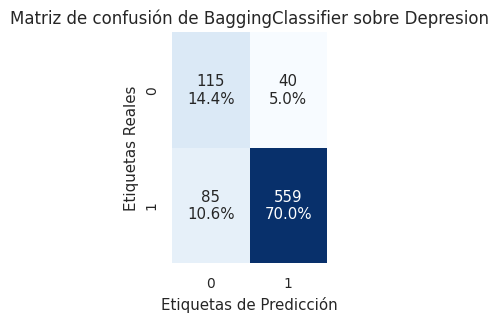

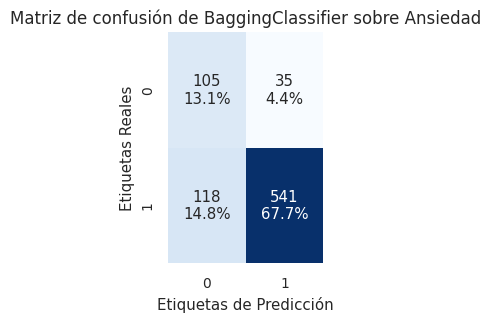

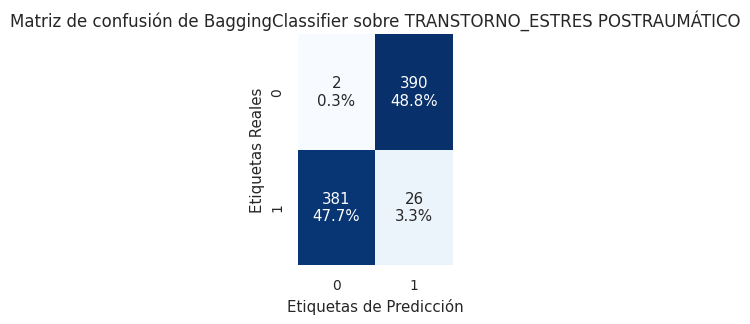

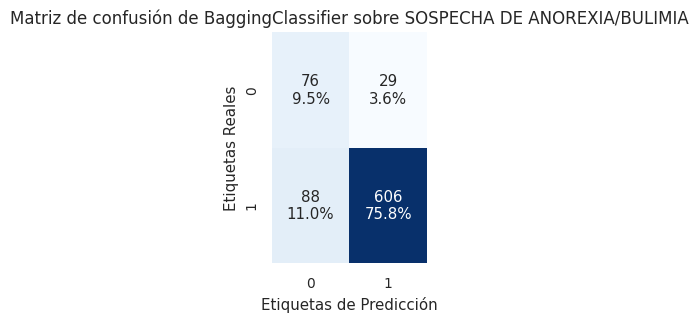

In [154]:
# Visualizamos las matrices de confusión para mayor detalle en el desempeño del
# modelo final sobre la clase minoritaria, que es donde hay presencia de algún trastorno.

for i in range(len(Ytransformed_df.columns)):
  final_est = final_bag_model.fit(X_train.astype('object'), Ytransformed_df.iloc[:,i])

  y_hat=final_est.predict(X_test)

  cm = confusion_matrix(ytestTransf_df.iloc[:,i], y_hat)

  # Visualizamos los resultados del modelo en una matriz de confusión

  frecuencia = ["{0:0.0f}".format(value) for value in cm.flatten()]
  porcentaje = ["{0:.1%}".format(value) for value in cm.flatten()/np.sum(cm)]

  labels = [f"{v1}\n{v2}" for v1, v2 in zip(frecuencia,porcentaje)]
  labels = np.asarray(labels).reshape(2,2)
  sns.set(rc={'figure.figsize':(2,3)},font_scale=0.9)
  ax = sns.heatmap(cm, annot=labels, fmt='', cmap='Blues', cbar=False)
  ax.set(ylabel="Etiquetas Reales", xlabel="Etiquetas de Predicción")
  plt.title(f'Matriz de confusión de BaggingClassifier sobre {Ytransformed_df.columns[i]}',fontsize=12)
  plt.show()



De las matrices de confusión observamos que los modelos aun presentan algunos errores, potencialmente tendremos qué incrementar nuestro umbral de filtrado en MCA para mejorar el desempeño en general, sobre todo en la clase minoritaria, donde hay algunas predicciones que implican que las personas no tienen la enfermedad, cuando en realidad sí la presentan. En promedio, el 3.33% de las predicciones erroneas en todos los trastornos son FP, es decir están en en el tipo de error de interés del negocio.

# Gráfico ROC

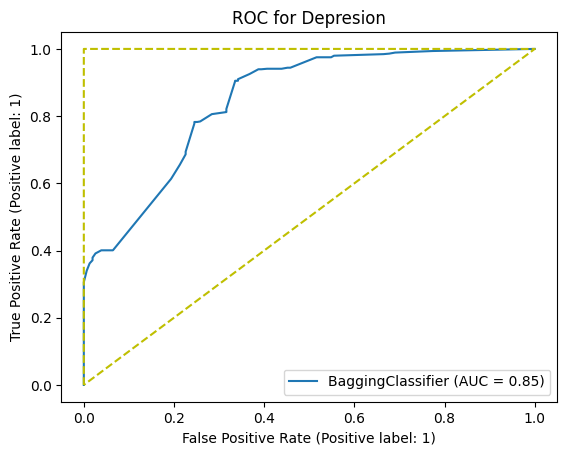

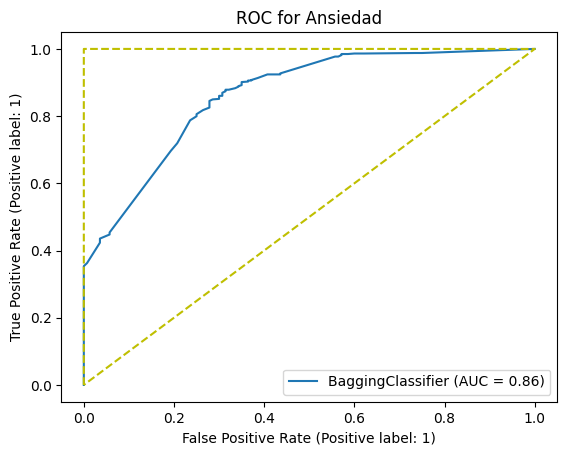

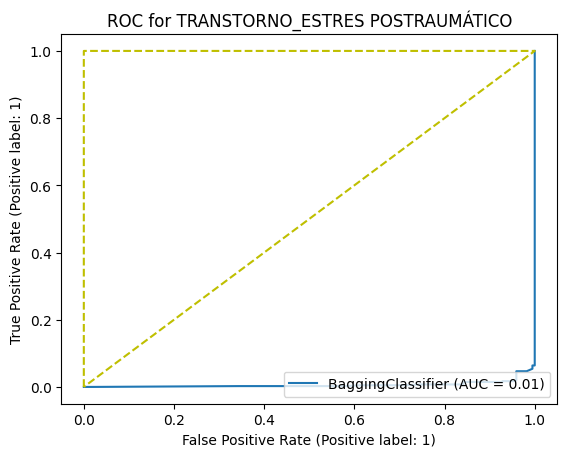

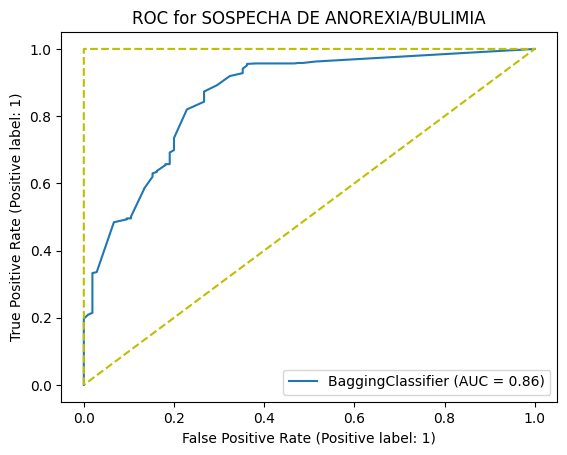

In [144]:

for i in range(len(Ytransformed_df.columns)):
  final_est = final_bag_model.fit(X_train.astype('object'), Ytransformed_df.iloc[:,i])


  RocCurveDisplay.from_estimator(final_est, X_test, ytestTransf_df.iloc[:,i])
  plt.title(f'ROC for {Ytransformed_df.columns[i]}')
  plt.plot([0,0,1,0],[0,1,1,0], 'y--')

  plt.show()

Estamos visualizando un gráfico por tipo de variable de salida para el modelo final, que es Bagging Classifier utilizando 10 árboles de desición.

De las gráficas de ROC podemos ver que en la clase TRASTORNO ESTRÉS POST-TRAUMÁTICO donde hicimos un balanceo de los datos, es donde tenemos un mejor resultado, aunque tenemos una gráfica inversa y habría qué convertir los valores de las categorías de positivo a negativo así como evaluar si no hay overfitting.

#Importancia de Características

In [155]:
import matplotlib.pyplot as plt
import numpy as np

# Nombres de las características
feature_names = np.array(X_train.columns.tolist())

# Función para visualizar la importancia de las características
def plot_feature_importances(importances, feature_names, title):
    # Ordenar las importancias y sus índices
    indices = np.argsort(importances)[::-1]
    sorted_feature_names = feature_names[indices]

    # Seleccionar las 10 características más importantes
    top_indices = indices[:10]
    top_importances = importances[top_indices]
    top_feature_names = sorted_feature_names[:10]

    # Crear el gráfico
    plt.figure(figsize=(10, 6))
    plt.title(title)
    plt.barh(range(len(top_indices)), top_importances, align='center')
    plt.yticks(range(len(top_indices)), top_feature_names)
    plt.gca().invert_yaxis()  # Invertir el eje y para tener la característica más importante en la parte superior
    plt.xlabel('Importancia de la Característica')
    plt.ylabel('Característica')
    plt.show()

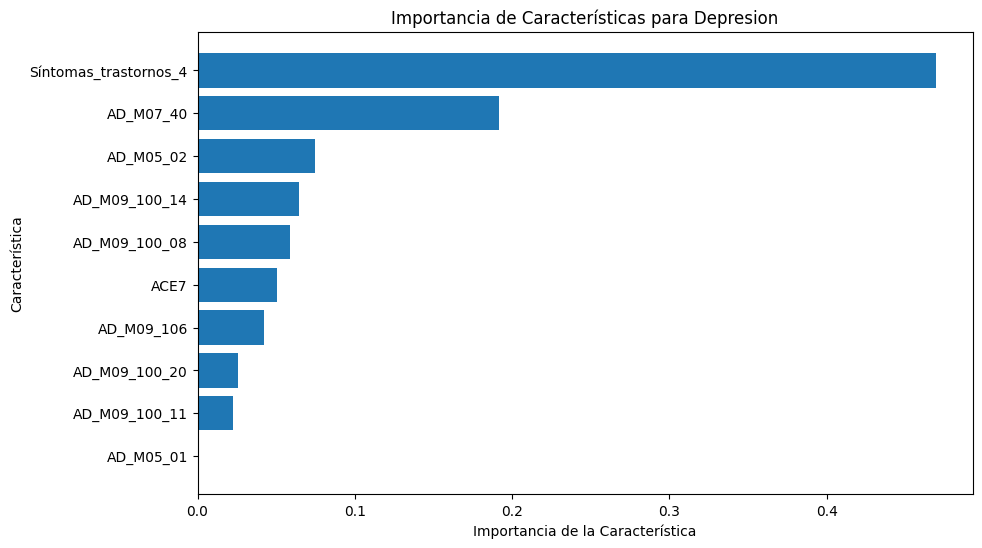

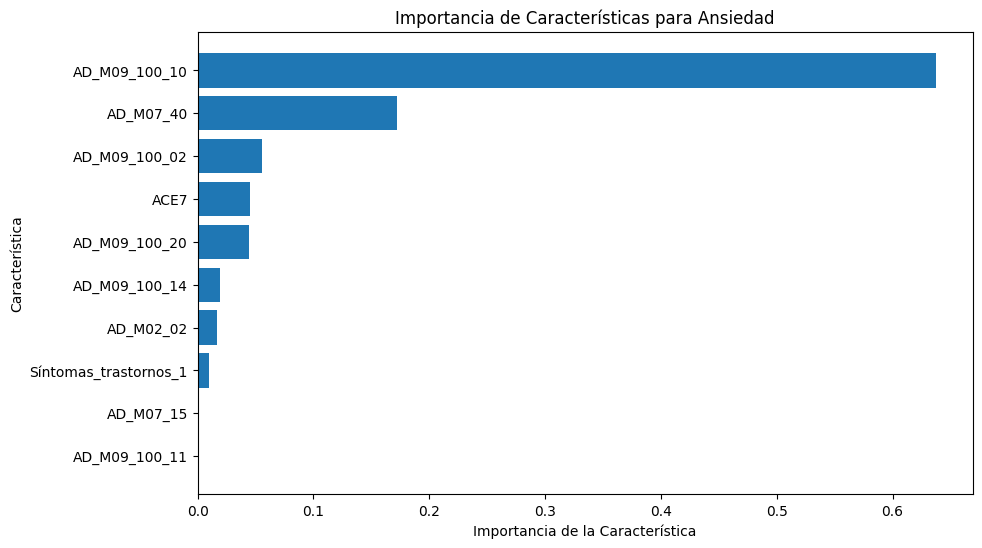

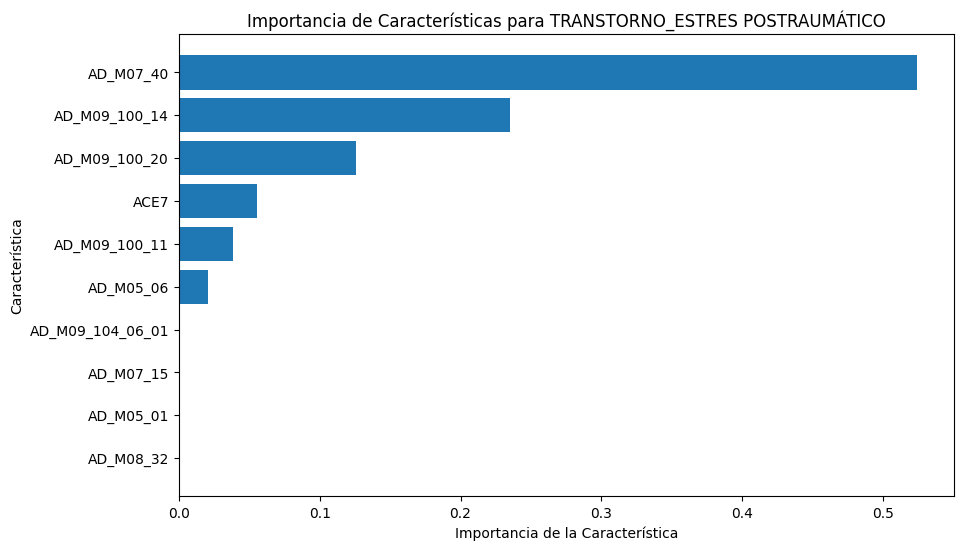

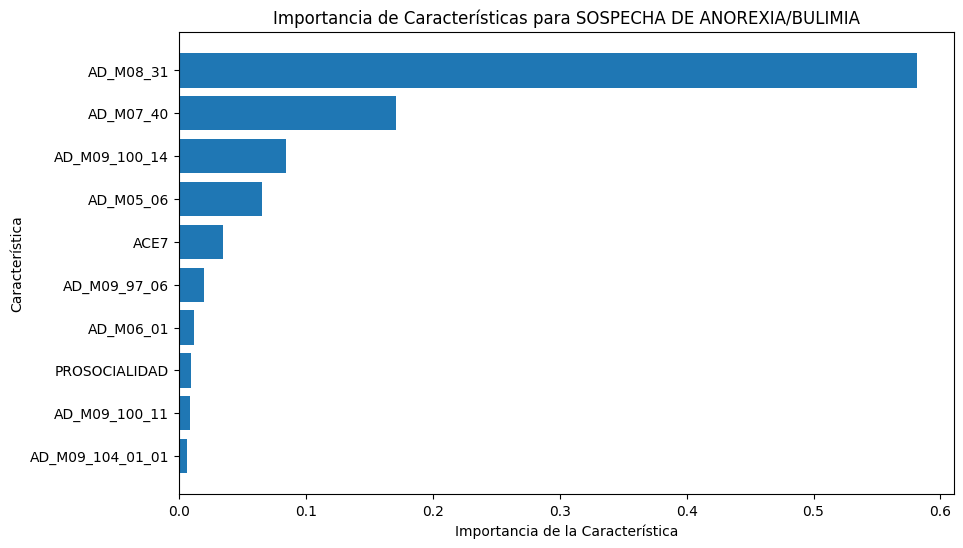

In [ ]:
for target in Ytransformed_df.columns:
  base_est = final_bag_model.fit(Xtransformed_df.astype('object'), Ytransformed_df[target])
  feature_importances = np.mean([tree.feature_importances_ for tree in base_est.estimators_], axis=0)
  plot_feature_importances(feature_importances, feature_names, f"Importancia de Características para {target}")


#Diagramas de árbol para Bagging Classifier

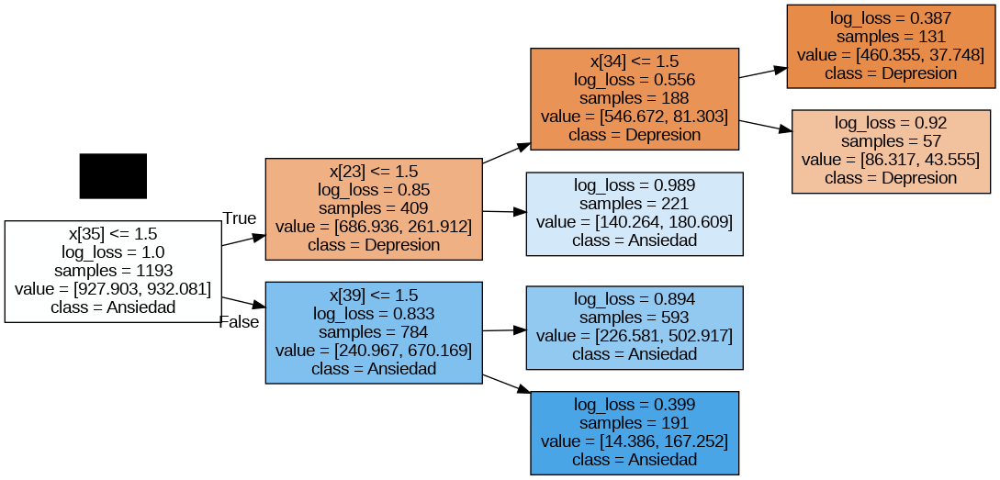

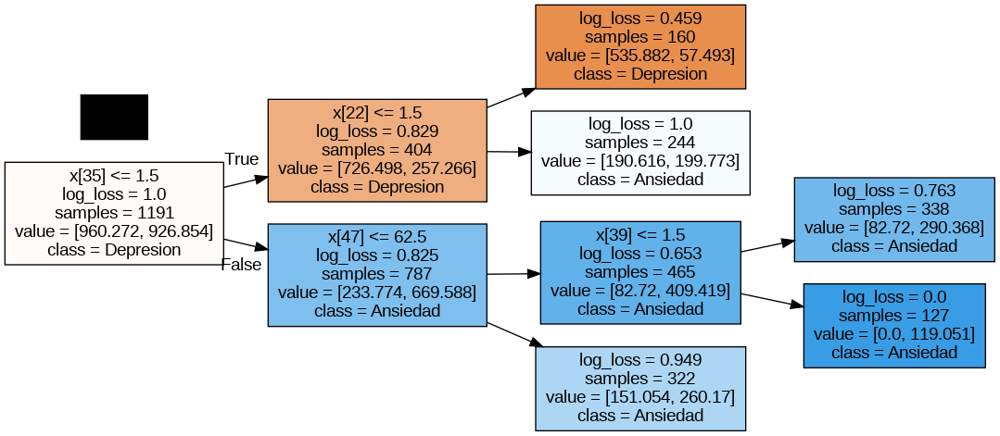

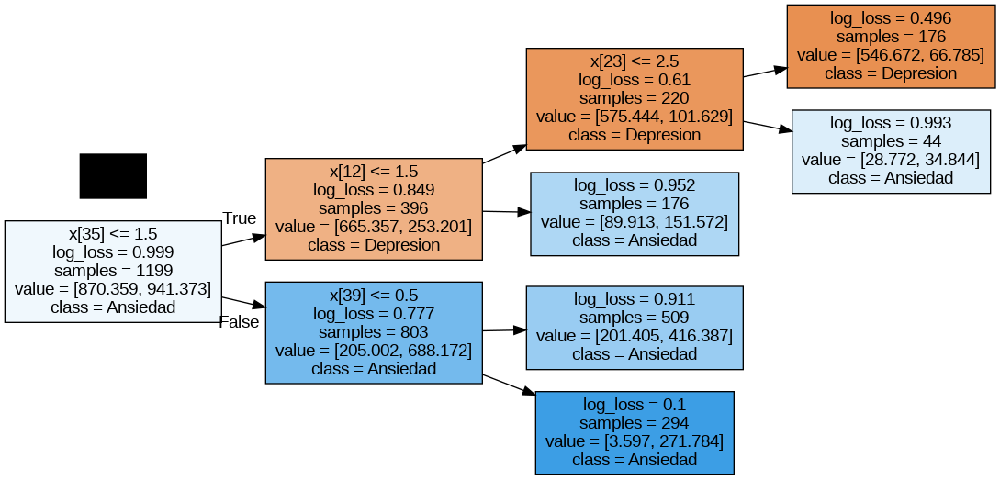

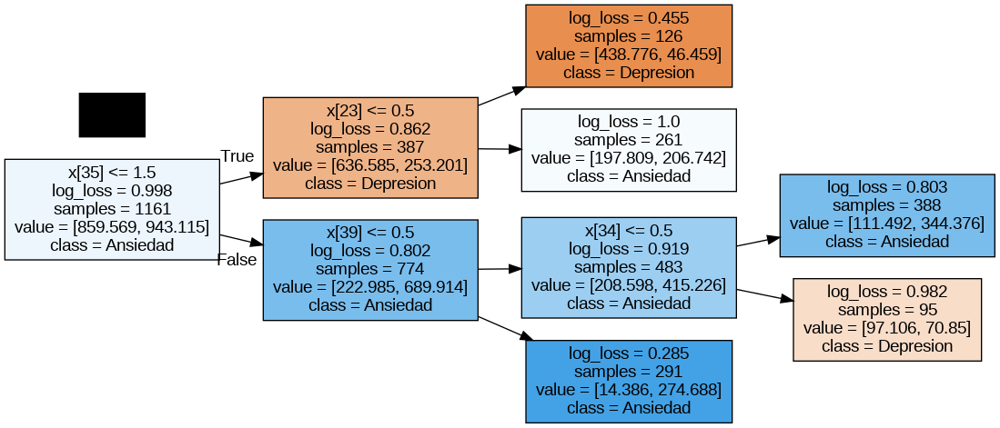

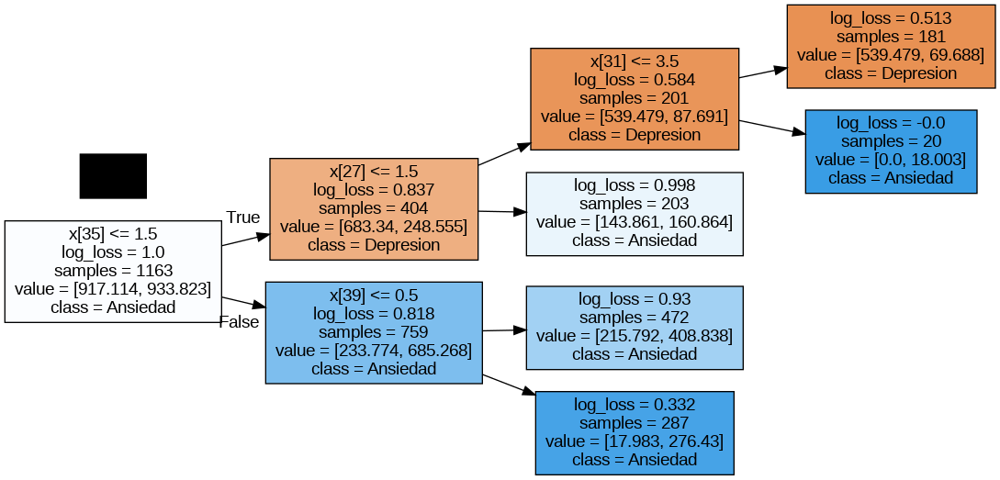

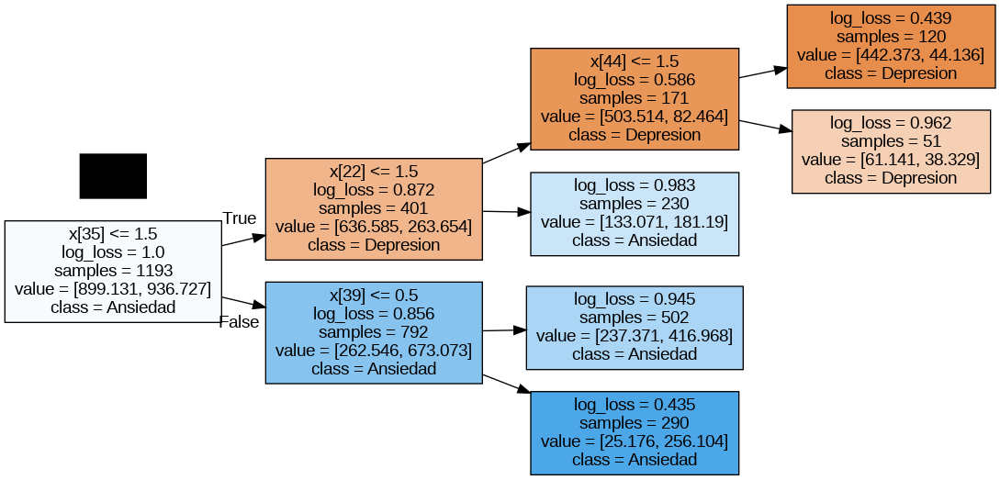

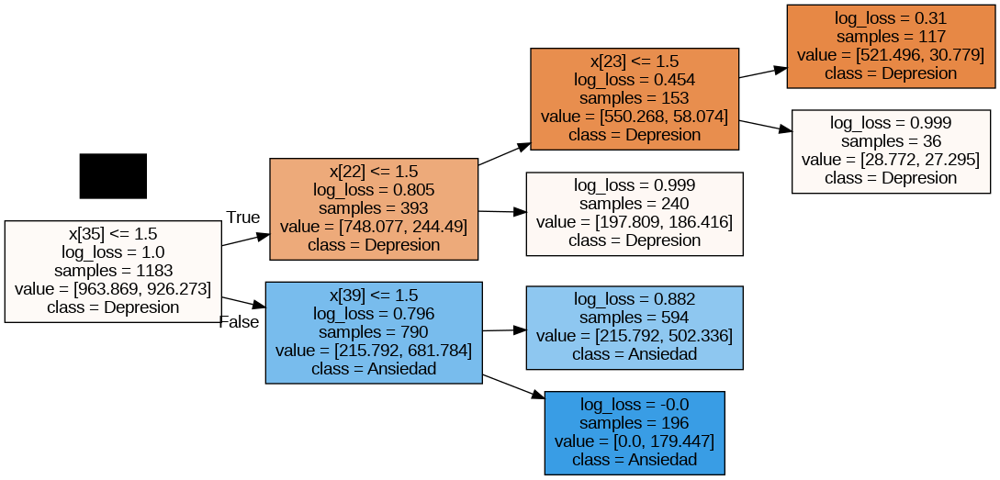

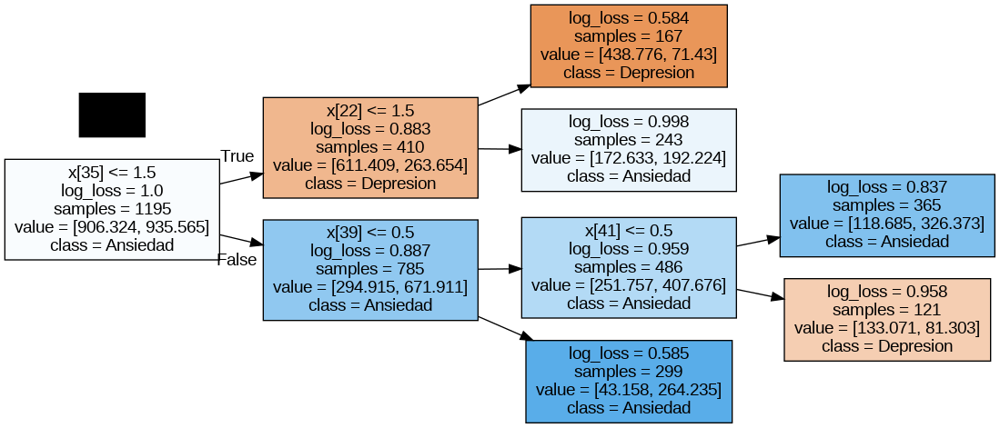

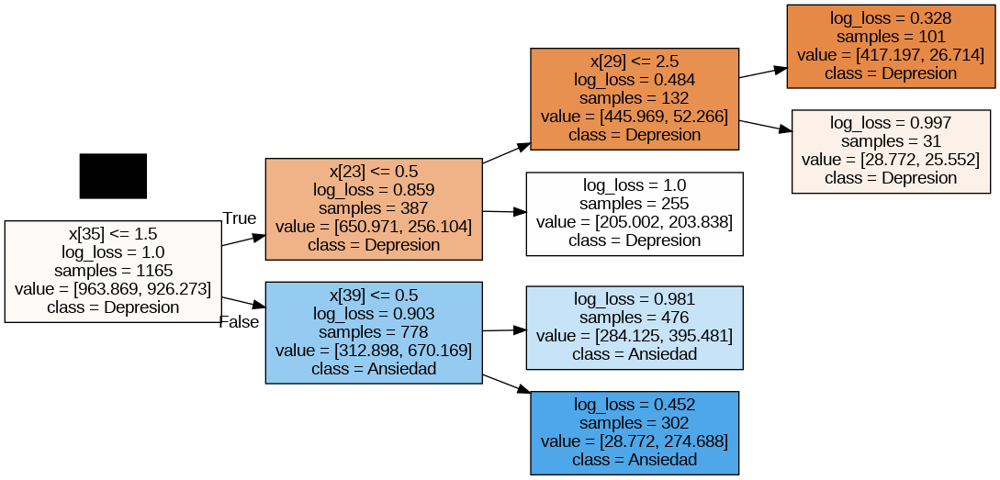

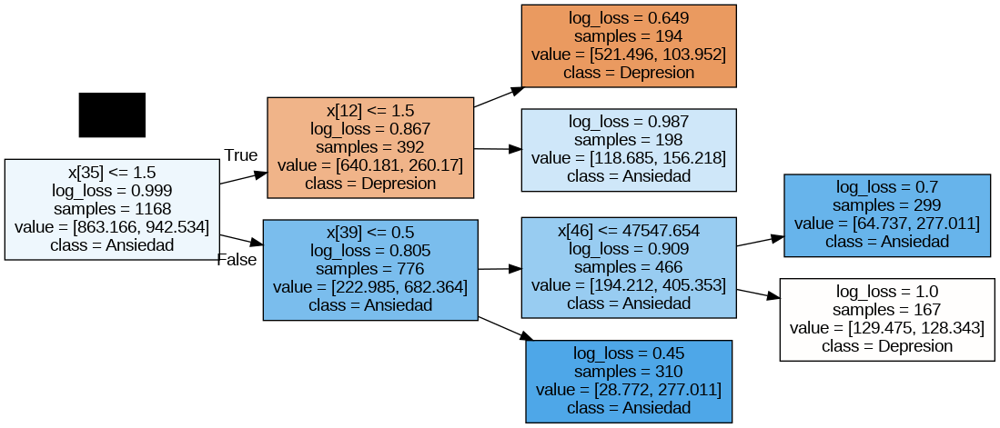

In [ ]:
# Creamos un objeto con nuestro modelo entrenado:
base_est = final_bag_model.fit(Xtransformed_df.astype('object'), Ytransformed_df[target])


for tree_in_forest in base_est.estimators_:

  dot_data = tree.export_graphviz(decision_tree=tree_in_forest,
                                  out_file=None,
                                  max_depth=None,
                                  feature_names=None,
                                  class_names=[y.columns[0], y.columns[1], y.columns[2],y.columns[3]],
                                  filled=True,
                                  rotate=True,
                                  proportion=False)

  graph = pydotplus.graph_from_dot_data(dot_data)
  display(Image(graph.create_png()))

# Curvas de aprendizaje

Evaluamos el efecto de agregar más muestras a los ciclos de entrenamiento de los modelos en cada época, así como su capacidad de generalizar en los subconjuntos de prueba para determinar si existe una condición de sub-ajuste o sobre-ajuste.

In [ ]:
# Creamos una función par automatizar la generación de las curvas de aprendizaje

def mi_LearningCurvePlot(train_sizes, train_scores, val_scores, model_name, target):

    # Obtenemos los promedios y desviaciones estándar de cada renglón de los resultados de entrenamiento y validación
    train_mean = np.mean(train_scores, axis=1)
    train_std = np.std(train_scores, axis=1)
    val_mean = np.mean(val_scores, axis=1)
    val_std = np.std(val_scores, axis=1)

    # Graficamos las curvas de aprendizaje incluyendo una región indicando la desviación estándar.
    plt.figure(figsize=(4,3))
    plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training')
    plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.1, color='blue')

    plt.plot(train_sizes, val_mean, color='red', marker='+', markersize=5, linestyle='--', label='Validation')
    plt.fill_between(train_sizes, val_mean + val_std, val_mean - val_std, alpha=0.1, color='red')

    plt.title(f'Curvas de Aprendizaje de {model_name} sobre {target} incrementando el tamaño de la muestra')
    plt.xlabel('Tamaño del conjunto de entrenamiento')
    plt.ylabel('Exactitud (accuracy)')
    plt.grid()
    plt.legend(loc='lower left')
    plt.show()

In [ ]:
def mi_ModeloYCurvas(Xin, modelo, target, model_name):

       mi_pipe = Pipeline([('col_transformer', columnasTransformerX),
        ('imputer',SimpleImputer(strategy='most_frequent')),
         ('modelo', modelo)])

       mi_kfold = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=7)


       delta_train_sz = np.linspace(0.1,1,40)

       tr_sizes, tr_scores, val_scores = learning_curve(estimator = mi_pipe,
                                                        X = Xin,
                                                        y = Ytransformed_df[target],
                                                        cv = mi_kfold,
                                                        train_sizes = delta_train_sz,
                                                        random_state=11)

       # Obtenemos el gráfico con las curvas de aprendizaje:
       mi_LearningCurvePlot(tr_sizes, tr_scores, val_scores, model_name, target)


Curvas de aprendizaje del modelo lineal:


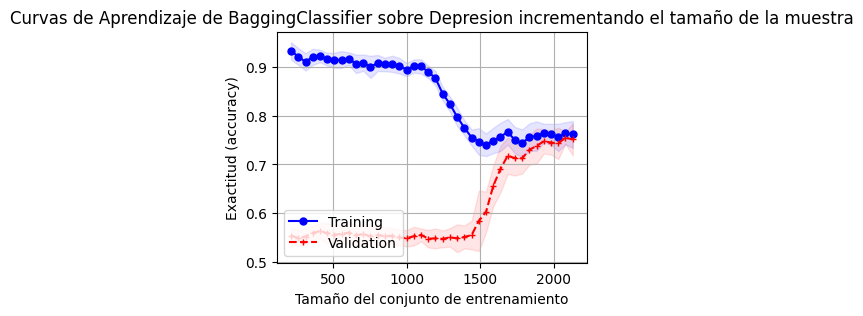

Curvas de aprendizaje del modelo lineal:


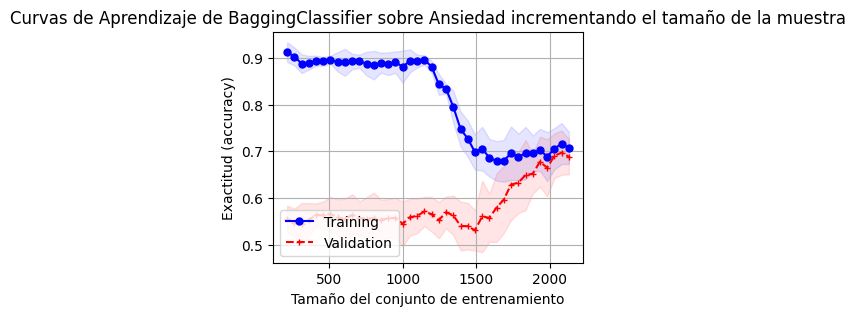

Curvas de aprendizaje del modelo lineal:


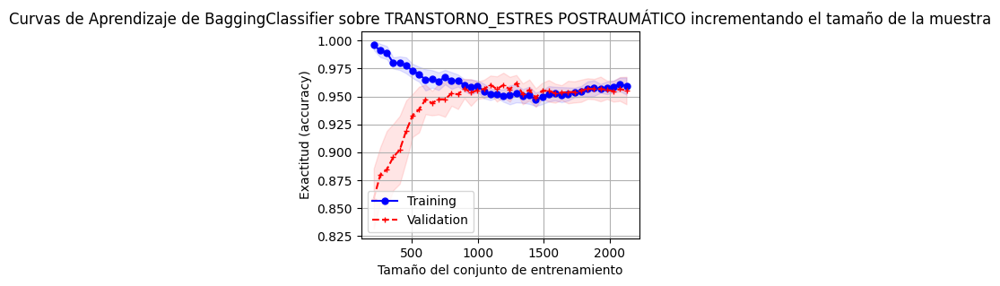

Curvas de aprendizaje del modelo lineal:


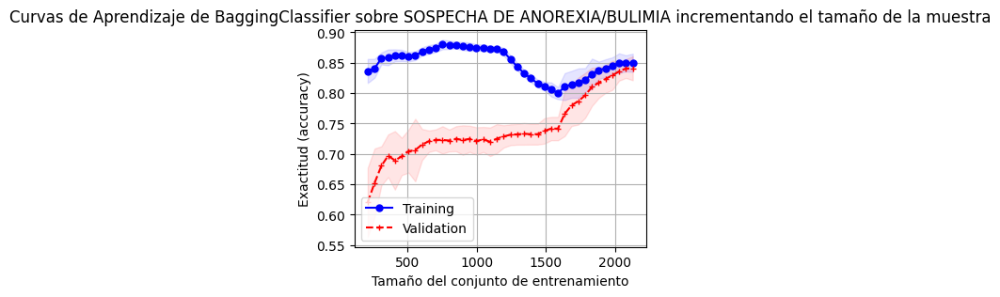

In [ ]:
# Verificamos las curvas de entrenamiento que se obtienen con 62 variables de entrada:

#for name,model in models.items():
for target in Ytransformed_df.columns:
  print('Curvas de aprendizaje del modelo lineal:')
  mi_ModeloYCurvas(X, final_bag_model, target, 'BaggingClassifier')

**Sub-Ajuste Vs Sobre-Ajuste**

Se observa que el modelo no está ni sub ni sobre ajustado en ningun target, aunque aparentemente empieza con una diferencia significativa entre el desempeño en la métrica de Exactitud entre el conjunto de entrenamiento y el de validación, pero gradualmente la curva de aprendizaje de validación va mejorando hasta prácticamente converger con la de entrenamiento, por lo que podemos concluír que el modelo está aprendiendo de datos nuevos. Tendremos que hacer algunas pruebas de balanceao y selección de datos para los targets con un desempeño más pobre para la entrega final.

**Referencias:**

Galli, S. (2022, October). *Python Feature Engineering Cookbook - Second Edition*. Packt Publishing.

Géron, A. (2022). *Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow, 3rd Edition*. O'Reilly Media, Inc.